## Longevity Bayes Net


First we create a Pomegranate Bayesian Network using the protobuf interface and our utility package, bayesnet, that enables one to conveniently create a Bayesian network by hand, and in accord with common statistics and rules, without having to fill in every probability.  The same Baysian network can start with our hand entered rules, but can later learn from data.  Any amount of questions can be answered, including no questions, to get the probabilities .  The file the Bayesian net is written in is longevity_bayes.py.  Our utility package can then be used to query the network with different evidence of states.  This is convenient for tuning hand entered parameters .



In [1]:
import sys
!{sys.executable} -m pip install --upgrade pip
!{sys.executable} -m pip install -e ../bayesnet
!{sys.executable} -m pip install matplotlib
!{sys.executable} -m pip install networkx
!{sys.executable} -m pip install graphviz
!{sys.executable} -m pip install datetime
!{sys.executable} -m pip install grpcio
!{sys.executable} -m pip install --no-cache-dir --upgrade numpy
!{sys.executable} -m pip install pomegranate==0.14.0
!{sys.executable} -m pip install qpsolvers
!{sys.executable} -m pip install osqp





Obtaining file:///home/opencog/bayesnet
  Preparing metadata (setup.py) ... done
  Attempting uninstall: covid-bayes
    Found existing installation: covid-bayes 1.0
    Can't uninstall 'covid-bayes'. No files were found to uninstall.
  Running setup.py develop for covid-bayes


In [2]:
!{sys.executable} -m pip install -r requirements.txt
!sh buildproto.sh

### Longevity net
Here put the name of the network you have written with the protobuf and bayes utilities.  Our example is printed out.  We created 4 functions in our utility package: any_of, all_of, if_the_else, and avg, which can together be used to express almost any set of rules, documented elsewhere.  We also implemented a dependency rule with which one can enter statistics from Systematic Reviews and Meta analyses easily.  The last lines implement the creation of the description of the network,  bayesianNetwork , with the protobuf utilities, and then the creation of the Pomegranate network with the description.  

In [3]:
text_file = open('./sn_bayes/longevity_bayes.py')
#text_file = open('./sn_bayes/longevity_bayes_short.py')
file_content = text_file.read()
print(file_content)
text_file.close()

import sn_bayes
from sn_bayes.utils import any_of
from sn_bayes.utils import all_of
from sn_bayes.utils import avg
from sn_bayes.utils import if_then_else
from sn_bayes.utils import bayesInitialize
from sn_bayes.utils import addCpt
from sn_bayes.utils import dependency
from sn_bayes.utils import non_cpt_descriptions

import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import BayesianNetwork


def longevity_bayes():
        bayesianNetwork = BayesianNetwork()
        cpt = {}
        outstr = '' 
                
        #probabilities within distributions must sum to 1.0
    #questions left blank or "prefer not to answer" will be computed

    #anomalies
        
                # increasing variability in step is associated with 
                # loss of resiliance , the root of aging
                # https://www.nature.com/articles/s41467-021-23014-1
                
                #variablility of number of steps within a day

        anomaly = b

 Next run the file and print the rules in it in human readable format.  All routines are stateless.

## Timing:  compiling, computation, explaning
Below you see that it takes about 1 hour and 16 minutes to compile the file.  However, the user does not experience this delay, just the programmer.  Later this notebook you will see that the computation time, to get to the answer when it is running, is about 7 seconds.  Times to get an explanation depend on how many possible explanations we want to cover: for example, if there are 60 things to check, it takes 16 seconds.  We have made a way to retrieve the answers gradually over that time, if necessary.

In [4]:
import qpsolvers
print(qpsolvers.available_solvers)


['cvxopt', 'cvxpy', 'ecos', 'mosek', 'osqp', 'quadprog', 'scs']


In [5]:
import pickle
from os.path import exists
import sn_bayes
from sn_bayes import longevity_bayes

if exists("bayesianNetwork.pkl"):
        infile = open("bayesianNetwork.pkl",'rb')
        bayesianNetwork = pickle.load(infile)
        infile.close()
else:
        %time bayesianNetwork,outstr = longevity_bayes.longevity_bayes()
        print (outstr)
        outfile = open("bayesianNetwork.pkl",'wb')
        pickle.dump(bayesianNetwork,outfile)
        outfile.close()
 


start timing...
var_dict
{'elderly': 2.3}
prior_a
0.03
priors[age]
{'elderly': 0.04999999981373565, 'adult': 0.24999999534338715, 'young_adult': 0.3000000063329933, 'teen': 0.19999999925494197, 'child': 0.19999999925494197}
prob_dict
{'elderly': {'prob_a_given_b': 0.06478873240909687, 'prob_not_a_given_b': 0.9352112675909031, 'prob_a_given_not_b': 0.028169014090911687, 'prob_not_a_given_not_b': 0.9718309859090883}, 'adult': {'prob_a_given_b': 0.028169014090911687, 'prob_not_a_given_b': 0.9718309859090883, 'prob_a_given_not_b': 0.03061032862120509, 'prob_not_a_given_not_b': 0.969389671378795}, 'young_adult': {'prob_a_given_b': 0.028169014090911687, 'prob_not_a_given_b': 0.9718309859090883, 'prob_a_given_not_b': 0.030784708270416666, 'prob_not_a_given_not_b': 0.9692152917295833}, 'teen': {'prob_a_given_b': 0.028169014090911687, 'prob_not_a_given_b': 0.9718309859090883, 'prob_a_given_not_b': 0.03045774647514053, 'prob_not_a_given_not_b': 0.9695422535248595}, 'child': {'prob_a_given_b': 0.

/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/typing.py:49: UserWarning: Converted P to scipy.sparse.csc.csc_matrix
For best performance, build P as a scipy.sparse.csc_matrix rather than as a numpy.ndarray
  f"Converted {matrix_name} to scipy.sparse.csc.csc_matrix\n"
/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/typing.py:49: UserWarning: Converted A to scipy.sparse.csc.csc_matrix
For best performance, build A as a scipy.sparse.csc_matrix rather than as a numpy.ndarray
  f"Converted {matrix_name} to scipy.sparse.csc.csc_matrix\n"


[1.  1.  0.3 0.7]
lhs_ineq
[array([0., 1., 0., 0.]), array([1., 0., 0., 0.]), array([0., 0., 0., 1.]), array([0., 0., 1., 0.]), array([-0., -1., -0., -0.]), array([-1., -0., -0., -0.]), array([-0., -0., -0., -1.]), array([-0., -0., -1., -0.])]
rhs_ineq
[0.783018867993849, 1.0, 1.0, 0.6509433960184526, -0.0, -0.34905660398154736, -0.216981132006151, -0.0]
lb
[0. 0. 0. 0.]
ub
[1. 1. 1. 1.]
opt
[0.66528633 0.28870248 0.33471367 0.71129752]
window
0.25
P
[[1. 0. 0. 0.]
 [0. 2. 0. 0.]
 [0. 0. 2. 0.]
 [0. 0. 0. 1.]]
q
[0. 0. 0. 0.]
lhs_eq
[[1.   0.   1.   0.  ]
 [0.   1.   0.   1.  ]
 [0.03 0.97 0.   0.  ]
 [0.   0.   0.03 0.97]]
rhs_eq
[1.  1.  0.3 0.7]
lhs_ineq
[array([0., 1., 0., 0.]), array([1., 0., 0., 0.]), array([0., 0., 0., 1.]), array([0., 0., 1., 0.]), array([-0., -1., -0., -0.]), array([-1., -0., -0., -0.]), array([-0., -0., -0., -1.]), array([-0., -0., -1., -0.])]
rhs_ineq
[0.533018867993849, 1.0, 0.966981132006151, 0.40094339601845264, -0.033018867993849066, -0.5990566039815474,

/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/osqp_.py:156: UserWarning: OSQP exited with status 'primal infeasible'
  warn("OSQP exited with status '%s'" % res.info.status)


frequencies[c]
0.07999999761581437
i:c
1
('bmi_35_to_39_moderate_risk',)
frequencies[c]
0.10000000074505817
i:c
2
('bmi_30_to_34_low_risk',)
frequencies[c]
0.20000000149011615
i:c
3
('bmi_25_to_29_overweight',)
frequencies[c]
0.30000000968575463
i:c
4
('bmi_under_25_healthy',)
frequencies[c]
0.3199999904632568
before norm:
rhs_inequality_equation2
{'bmi': {'bmi_over_40_high_risk': 0.5, 'bmi_35_to_39_moderate_risk': 0.5}}
lhs_inequality_equation2
{'bmi': {'bmi_over_40_high_risk': array([0.08, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ]), 'bmi_35_to_39_moderate_risk': array([0. , 0.1, 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ])}}
rhs_inequality_equation4
{'bmi': {'bmi_over_40_high_risk': 0.5, 'bmi_35_to_39_moderate_risk': 0.5}}
lhs_inequality_equation4
{'bmi': {'bmi_over_40_high_risk': array([0.  , 0.  , 0.  , 0.  , 0.  , 0.08, 0.  , 0.  , 0.  , 0.  ]), 'bmi_35_to_39_moderate_risk': array([0. , 0. , 0. , 0. , 0. , 0. , 0.1, 0. , 0. , 0. ])}}
rhs_inequality_equation1
{'bmi': {'bmi_

i:c
0
('bmi_over_40_high_risk', 'dietary_energy_above_3939.00', 'lack_of_exercise')
frequencies[c]
0.0022325777514959296
i:c
1
('bmi_over_40_high_risk', 'dietary_energy_above_3939.00', 'no_lack_of_exercise')
frequencies[c]
0.0017674221950928924
i:c
2
('bmi_over_40_high_risk', 'dietary_energy_above_2612.00_to_3939.00_and_below', 'lack_of_exercise')
frequencies[c]
0.00893031100598369
i:c
3
('bmi_over_40_high_risk', 'dietary_energy_above_2612.00_to_3939.00_and_below', 'no_lack_of_exercise')
frequencies[c]
0.007069688780371547
i:c
4
('bmi_over_40_high_risk', 'dietary_energy_above_1930.00_to_2612.00_and_below', 'lack_of_exercise')
frequencies[c]
0.011162888591139607
i:c
5
('bmi_over_40_high_risk', 'dietary_energy_above_1930.00_to_2612.00_and_below', 'no_lack_of_exercise')
frequencies[c]
0.008837110843781217
i:c
6
('bmi_over_40_high_risk', 'dietary_energy_above_1399.00_to_1930.00_and_below', 'lack_of_exercise')
frequencies[c]
0.011162888591139607
i:c
7
('bmi_over_40_high_risk', 'dietary_ener

opt
[0.98268951 0.96260302 0.95036589 0.92884344 0.91344755 0.89144645
 0.87423187 0.85223077 0.83501618 0.81301508 0.78718542 0.76697926
 0.75658481 0.73458371 0.72024082 0.6976414  0.68102513 0.65842571
 0.64180944 0.61921003 0.59397868 0.57317421 0.57199315 0.54759879
 0.53852085 0.51292986 0.49930516 0.47371417 0.46008948 0.43449849
 0.40077194 0.37936915 0.38740149 0.36061387 0.35680088 0.32821832
 0.3175852  0.28900263 0.27836951 0.24978695 0.20526785 0.1837454
 0.19362041 0.16635414 0.16359414 0.13441326 0.12437845 0.09519758
 0.08516277 0.05598189 0.01731049 0.03739698 0.04963411 0.07115656
 0.08655245 0.10855355 0.12576813 0.14776923 0.16498382 0.18698492
 0.21281458 0.23302074 0.24341519 0.26541629 0.27975918 0.3023586
 0.31897487 0.34157429 0.35819056 0.38078997 0.40602132 0.42682579
 0.42800685 0.45240121 0.46147915 0.48707014 0.50069484 0.52628583
 0.53991052 0.56550151 0.59922806 0.62063085 0.61259851 0.63938613
 0.64319912 0.67178168 0.6824148  0.71099737 0.72163049 0.75

       0.        , 0.14141414, 0.21212121, 0.34343435, 0.22222222])}}
after norm:
rhs_inequality_equation2
{'eat_out_how_many_times_per_week': {'eat_out_more_than_7_times_per_week': 0.41260744985673337}}
lhs_inequality_equation2
{'eat_out_how_many_times_per_week': {'eat_out_more_than_7_times_per_week': array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.])}}
rhs_inequality_equation4
{'eat_out_how_many_times_per_week': {'eat_out_more_than_7_times_per_week': 0.5873925501432665}}
lhs_inequality_equation4
{'eat_out_how_many_times_per_week': {'eat_out_more_than_7_times_per_week': array([0., 0., 0., 0., 0., 1., 0., 0., 0., 0.])}}
rhs_inequality_equation1
{'eat_out_how_many_times_per_week': {'eat_out_more_than_7_times_per_week': 0.055299539170506916}}
lhs_inequality_equation1
{'eat_out_how_many_times_per_week': {'eat_out_more_than_7_times_per_week': array([0.        , 0.15384616, 0.23076922, 0.37362638, 0.24175824,
       0.        , 0.        , 0.        , 0.        , 0.        ])}}
rhs_inequality_

       -0.        , -0.33333333, -0.33333333, -0.26666667, -0.06666667]), array([-0., -0., -0., -0., -0., -1., -0., -0., -0., -0.])]
rhs_ineq
[0.6313868613138687, 1.0, 1.0, 0.8333333333333333, -0.0, -0.16666666666666674, -0.36861313868613144, -0.0]
lb
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
ub
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
opt
[0.53442029 0.36775362 0.20108696 0.0942029  0.10688406 0.46557971
 0.63224638 0.79891304 0.9057971  0.89311594]
window
0.25
P
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 2. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 3. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 4. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 5. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 5. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 4. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 3. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 2. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
q
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
lhs_eq
[[1.   0.   0.   0.   0.   1.   0.   0.   0.   0.  ]
 [0.   1.   0.   0.   0.   0.   1.   0.   0.   0.  ]
 [0.   0.   1.   0.   0.   0.   0.   1.   0.   0.  ]
 [0.   0.   0.   1.

opt
[0.59544314 0.17417102 0.40455686 0.82582898]
window
0.125
P
[[1. 0. 0. 0.]
 [0. 2. 0. 0.]
 [0. 0. 2. 0.]
 [0. 0. 0. 1.]]
q
[0. 0. 0. 0.]
lhs_eq
[[1.   0.   1.   0.  ]
 [0.   1.   0.   1.  ]
 [0.18 0.82 0.   0.  ]
 [0.   0.   0.18 0.82]]
rhs_eq
[1.   1.   0.25 0.75]
lhs_ineq
[array([0., 1., 0., 0.]), array([1., 0., 0., 0.]), array([0., 0., 0., 1.]), array([0., 0., 1., 0.]), array([-0., -1., -0., -0.]), array([-1., -0., -0., -0.]), array([-0., -0., -0., -1.]), array([-0., -0., -1., -0.])]
rhs_ineq
[0.16500000000000004, 0.47045454545454546, 1.0, 0.7795454545454544, -0.0, -0.22045454545454546, -0.835, -0.5295454545454544]
lb
[0. 0. 0. 0.]
ub
[1. 1. 1. 1.]
opt
None
cpt_rows
[['salt_very_often', 'dietary_sodium_above_4297.00', 0.5954431352331414], ['salt_very_often', 'no_dietary_sodium_above_4297.00', 0.4045568647668586], ['no_salt_very_often', 'dietary_sodium_above_4297.00', 0.17417102291958741], ['no_salt_very_often', 'no_dietary_sodium_above_4297.00', 0.8258289770804126]]
{'dietary_s

       -0.02816901, -0.        , -0.18309859, -0.21126761, -0.57746479]), array([-0., -0., -0., -0., -0., -0., -1., -0., -0., -0.])]
rhs_ineq
[0.6829268292682927, 1.0, 1.0, 0.9965126416739319, -0.0, -0.0034873583260680574, -0.31707317073170727, -0.0, 0.6829268292682927, 1.0, 1.0, 0.9965126416739319, -0.0, -0.0034873583260680574, -0.31707317073170727, -0.0]
lb
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
ub
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
opt
[0.82930199 0.61224359 0.4737963  0.30309829 0.08402421 0.17069801
 0.38775641 0.5262037  0.69690171 0.91597579]
window
0.25
P
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 2. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 3. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 4. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 5. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 5. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 4. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 3. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 2. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
q
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
lhs_eq
[[1.         0.         0.         0.         0.         1.
  0.    

i:c
0
('times_brush_teeth_daily_1_or_less', 'floss_days_per_week_3_or_less')
frequencies[c]
0.2077194682719455
i:c
1
('times_brush_teeth_daily_1_or_less', 'no_floss_days_per_week_3_or_less')
frequencies[c]
0.12228053160289228
i:c
2
('no_times_brush_teeth_daily_1_or_less', 'floss_days_per_week_3_or_less')
frequencies[c]
0.05228053236433309
i:c
3
('no_times_brush_teeth_daily_1_or_less', 'no_floss_days_per_week_3_or_less')
frequencies[c]
0.6177194677608294
before norm:
rhs_inequality_equation2
{'times_brush_teeth_daily': {'times_brush_teeth_daily_1_or_less': 0.4258675078864354}, 'floss_days_per_week': {'floss_days_per_week_3_or_less': 0.30321592649310863}}
lhs_inequality_equation2
{'times_brush_teeth_daily': {'times_brush_teeth_daily_1_or_less': array([0.20771947, 0.12228053, 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        ])}, 'floss_days_per_week': {'floss_days_per_week_3_or_less': array([0.20771947, 0.        , 0.05228053, 0.        , 0.        ,
       0. 

i:c
0
('times_brush_teeth_daily_1_or_less', 'floss_days_per_week_3_or_less')
frequencies[c]
0.20771947253351242
i:c
1
('times_brush_teeth_daily_1_or_less', 'no_floss_days_per_week_3_or_less')
frequencies[c]
0.12228052682310876
i:c
2
('no_times_brush_teeth_daily_1_or_less', 'floss_days_per_week_3_or_less')
frequencies[c]
0.05228053240476995
i:c
3
('no_times_brush_teeth_daily_1_or_less', 'no_floss_days_per_week_3_or_less')
frequencies[c]
0.6177194682386089
before norm:
rhs_inequality_equation2
{'times_brush_teeth_daily': {'times_brush_teeth_daily_1_or_less': 0.3409906676238335}, 'floss_days_per_week': {'floss_days_per_week_3_or_less': 0.38243366880146384}}
lhs_inequality_equation2
{'times_brush_teeth_daily': {'times_brush_teeth_daily_1_or_less': array([0.20771947, 0.12228053, 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        ])}, 'floss_days_per_week': {'floss_days_per_week_3_or_less': array([0.20771947, 0.        , 0.05228053, 0.        , 0.        ,
       0.

i:c
0
('gum_disease_yes', 'teeth_health_poor')
frequencies[c]
0.0443367456862952
i:c
1
('gum_disease_yes', 'no_teeth_health_poor')
frequencies[c]
0.1831770155850061
i:c
2
('gum_disease_no', 'teeth_health_poor')
frequencies[c]
0.07273284580737652
i:c
3
('gum_disease_no', 'no_teeth_health_poor')
frequencies[c]
0.699753392921322
before norm:
rhs_inequality_equation2
{'gum_disease': {'gum_disease_yes': 0.3308823529411764}, 'teeth_health': {'teeth_health_poor': 0.2070407807598466}}
lhs_inequality_equation2
{'gum_disease': {'gum_disease_yes': array([0.04433675, 0.18317702, 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        ])}, 'teeth_health': {'teeth_health_poor': array([0.04433675, 0.        , 0.07273285, 0.        , 0.        ,
       0.        , 0.        , 0.        ])}}
rhs_inequality_equation4
{'gum_disease': {'gum_disease_yes': 0.6691176470588236}, 'teeth_health': {'teeth_health_poor': 0.7929592192401533}}
lhs_inequality_equation4
{'gum_disease': {'gum_disea

i:c
0
('glucose_serum_above_155.00',)
frequencies[c]
0.050000000558793715
i:c
1
('glucose_serum_above_101.00_to_155.00_and_below',)
frequencies[c]
0.2000000022351742
i:c
2
('glucose_serum_above_92.00_to_101.00_and_below',)
frequencies[c]
0.24999999906867737
i:c
3
('glucose_serum_above_86.00_to_92.00_and_below',)
frequencies[c]
0.24999999906867737
i:c
4
('glucose_serum_86.00_and_below',)
frequencies[c]
0.24999999906867737
before norm:
rhs_inequality_equation2
{'glucose_serum': {'glucose_serum_above_155.00': 0.8104212860310421, 'glucose_serum_above_101.00_to_155.00_and_below': 0.8104212860310421}}
lhs_inequality_equation2
{'glucose_serum': {'glucose_serum_above_155.00': array([0.05, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ]), 'glucose_serum_above_101.00_to_155.00_and_below': array([0. , 0.2, 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ])}}
rhs_inequality_equation4
{'glucose_serum': {'glucose_serum_above_155.00': 0.18957871396895792, 'glucose_serum_above_101.00_to_155.00_and_below':

i:c
0
('fasting_glucose_high_above_100',)
frequencies[c]
0.43000000475233663
i:c
1
('no_fasting_glucose_high_above_100',)
frequencies[c]
0.5699999952476632
before norm:
rhs_inequality_equation2
{'fasting_glucose': {'fasting_glucose_high_above_100': 0.611819235225956}}
lhs_inequality_equation2
{'fasting_glucose': {'fasting_glucose_high_above_100': array([0.43, 0.  , 0.  , 0.  ])}}
rhs_inequality_equation4
{'fasting_glucose': {'fasting_glucose_high_above_100': 0.388180764774044}}
lhs_inequality_equation4
{'fasting_glucose': {'fasting_glucose_high_above_100': array([0.  , 0.  , 0.43, 0.  ])}}
rhs_inequality_equation1
{'fasting_glucose': {'fasting_glucose_high_above_100': 0.11609498680738786}}
lhs_inequality_equation1
{'fasting_glucose': {'fasting_glucose_high_above_100': array([0.  , 0.57, 0.  , 0.  ])}}
rhs_inequality_equation3
{'fasting_glucose': {'fasting_glucose_high_above_100': 0.883905013192612}}
lhs_inequality_equation3
{'fasting_glucose': {'fasting_glucose_high_above_100': array([

i:c
0
('heart_rate_anomaly',)
frequencies[c]
0.02999999849125768
i:c
1
('no_heart_rate_anomaly',)
frequencies[c]
0.9700000015087423
before norm:
rhs_inequality_equation2
{'heart_rate_anomaly': {'heart_rate_anomaly': 0.05940594059405939}}
lhs_inequality_equation2
{'heart_rate_anomaly': {'heart_rate_anomaly': array([0.03, 0.  , 0.  , 0.  ])}}
rhs_inequality_equation4
{'heart_rate_anomaly': {'heart_rate_anomaly': 0.9405940594059405}}
lhs_inequality_equation4
{'heart_rate_anomaly': {'heart_rate_anomaly': array([0.  , 0.  , 0.03, 0.  ])}}
rhs_inequality_equation1
{'heart_rate_anomaly': {'heart_rate_anomaly': 0.0468227424749164}}
lhs_inequality_equation1
{'heart_rate_anomaly': {'heart_rate_anomaly': array([0.  , 0.97, 0.  , 0.  ])}}
rhs_inequality_equation3
{'heart_rate_anomaly': {'heart_rate_anomaly': 0.9531772575250835}}
lhs_inequality_equation3
{'heart_rate_anomaly': {'heart_rate_anomaly': array([0.  , 0.  , 0.  , 0.97])}}
after norm:
rhs_inequality_equation2
{'heart_rate_anomaly': {'hear

i:c
0
('obesity', 'heart_rate_anomaly')
frequencies[c]
0.011399999404104562
i:c
1
('obesity', 'no_heart_rate_anomaly')
frequencies[c]
0.36859999984345015
i:c
2
('no_obesity', 'heart_rate_anomaly')
frequencies[c]
0.018599999087153117
i:c
3
('no_obesity', 'no_heart_rate_anomaly')
frequencies[c]
0.6014000016652921
before norm:
rhs_inequality_equation2
{'obesity': {'obesity': 0.03162055335968379}, 'heart_rate_anomaly': {'heart_rate_anomaly': 0.02}}
lhs_inequality_equation2
{'obesity': {'obesity': array([0.0114, 0.3686, 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ])}, 'heart_rate_anomaly': {'heart_rate_anomaly': array([0.0114, 0.    , 0.0186, 0.    , 0.    , 0.    , 0.    , 0.    ])}}
rhs_inequality_equation4
{'obesity': {'obesity': 0.9683794466403162}, 'heart_rate_anomaly': {'heart_rate_anomaly': 0.98}}
lhs_inequality_equation4
{'obesity': {'obesity': array([0.    , 0.    , 0.    , 0.    , 0.0114, 0.3686, 0.    , 0.    ])}, 'heart_rate_anomaly': {'heart_rate_anomaly': array([0.    , 0.  

i:c
0
('lack_of_exercise', 'oxygen_anomaly')
frequencies[c]
0.01132628170576708
i:c
1
('lack_of_exercise', 'no_oxygen_anomaly')
frequencies[c]
0.5468181668921452
i:c
2
('no_lack_of_exercise', 'oxygen_anomaly')
frequencies[c]
0.008673718645764744
i:c
3
('no_lack_of_exercise', 'no_oxygen_anomaly')
frequencies[c]
0.4331818327563229
before norm:
rhs_inequality_equation2
{'lack_of_exercise': {'lack_of_exercise': 0.06403940886699508}, 'oxygen_anomaly': {'oxygen_anomaly': 0.14925373134328362}}
lhs_inequality_equation2
{'lack_of_exercise': {'lack_of_exercise': array([0.01132628, 0.54681817, 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        ])}, 'oxygen_anomaly': {'oxygen_anomaly': array([0.01132628, 0.        , 0.00867372, 0.        , 0.        ,
       0.        , 0.        , 0.        ])}}
rhs_inequality_equation4
{'lack_of_exercise': {'lack_of_exercise': 0.935960591133005}, 'oxygen_anomaly': {'oxygen_anomaly': 0.8507462686567164}}
lhs_inequality_equation4
{'lack_o

i:c
0
('lack_of_exercise', 'heart_rate_anomaly')
frequencies[c]
0.01674433258684546
i:c
1
('lack_of_exercise', 'no_heart_rate_anomaly')
frequencies[c]
0.5414001160110669
i:c
2
('no_lack_of_exercise', 'heart_rate_anomaly')
frequencies[c]
0.013255665855629964
i:c
3
('no_lack_of_exercise', 'no_heart_rate_anomaly')
frequencies[c]
0.4285998855464577
before norm:
rhs_inequality_equation2
{'lack_of_exercise': {'lack_of_exercise': 0.15111940298507462}, 'heart_rate_anomaly': {'heart_rate_anomaly': 0.4709302325581396}}
lhs_inequality_equation2
{'lack_of_exercise': {'lack_of_exercise': array([0.01674433, 0.54140012, 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        ])}, 'heart_rate_anomaly': {'heart_rate_anomaly': array([0.01674433, 0.        , 0.01325567, 0.        , 0.        ,
       0.        , 0.        , 0.        ])}}
rhs_inequality_equation4
{'lack_of_exercise': {'lack_of_exercise': 0.8488805970149254}, 'heart_rate_anomaly': {'heart_rate_anomaly': 0.529069767441

i:c
0
('diastolic_120_or_higher_crisis', 'systolic_180_over_crisis', 'high_blood_pressure_patient_prescription_yes', 'high_blood_pressure_medication_compliance_no')
frequencies[c]
8.099999844096856e-06
i:c
1
('diastolic_120_or_higher_crisis', 'systolic_180_over_crisis', 'high_blood_pressure_patient_prescription_yes', 'high_blood_pressure_medication_compliance_yes')
frequencies[c]
2.1899999280460877e-05
i:c
2
('diastolic_120_or_higher_crisis', 'systolic_180_over_crisis', 'high_blood_pressure_patient_prescription_no', 'high_blood_pressure_medication_compliance_no')
frequencies[c]
4.5899998580107027e-05
i:c
3
('diastolic_120_or_higher_crisis', 'systolic_180_over_crisis', 'high_blood_pressure_patient_prescription_no', 'high_blood_pressure_medication_compliance_yes')
frequencies[c]
0.0001240999944722319
i:c
4
('diastolic_120_or_higher_crisis', 'systolic_140_to_179_high_stage_2', 'high_blood_pressure_patient_prescription_yes', 'high_blood_pressure_medication_compliance_no')
frequencies[c]
7.

rhs_ineq
[1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0]
lb
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
ub
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1

rhs_ineq
[0.27274162981680355, 0.5953237410071941, 1.0, 0.9046762589928058, -0.0, -0.0953237410071941, -0.7272583701831964, -0.4046762589928058, 0.27274162981680355, 0.5953237410071941, 1.0, 0.9046762589928058, -0.0, -0.0953237410071941, -0.7272583701831964, -0.4046762589928058, 0.27274162981680355, 0.5953237410071941, 1.0, 0.9046762589928058, -0.0, -0.0953237410071941, -0.7272583701831964, -0.4046762589928058, 0.28191489361702127, 0.47881355932203384, 1.0, 1.0, -0.0, -0.0, -0.7180851063829787, -0.5211864406779662, 0.28191489361702127, 0.47881355932203384, 1.0, 1.0, -0.0, -0.0, -0.7180851063829787, -0.5211864406779662, 0.28191489361702127, 0.47881355932203384, 1.0, 1.0, -0.0, -0.0, -0.7180851063829787, -0.5211864406779662, 0.26715374841169, 0.6091549295774646, 1.0, 0.8908450704225352, -0.0, -0.10915492957746464, -0.7328462515883101, -0.39084507042253525, 0.26715374841169, 0.6091549295774646, 1.0, 0.8908450704225352, -0.0, -0.10915492957746464, -0.7328462515883101, -0.39084507042253525]

[array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       4.90909081e-05, 1.32727268e-04, 2.78181810e-04, 7.52121179e-04,
       4.41818201e-04, 1.19454549e-03, 2.50363644e-03, 6.76909103e-03,
       3.43636366e-04, 9.29090903e-04, 1.94727272e-03, 5.26484839e-03,
       3.92727265e-04, 1.06181815e-03, 2.22545448e-03, 6.01696943e-03,
       1.22727273e-03, 3.31818178e-03, 6.95454539e-03, 1.88030299e-02,
       1.39090911e-04, 3.76060606e-04, 7.88181820e-04, 2.13101008e-03,
       1.25181828e-03, 3.38454566e-03, 7.09363682e-03, 1.91790919e-02,
       9.73636403e-04, 2.63242431e-03, 5.51727288e-03, 1.49170709e-02,
       1.11272729e-03, 3.00848485e-03, 6.30545456e-03, 1.70480806e-02,
     

i:c
0
('inflammation_from_illness',)
frequencies[c]
0.31962641729702584
i:c
1
('no_inflammation_from_illness',)
frequencies[c]
0.6803735827029741
before norm:
rhs_inequality_equation2
{'inflammation_from_illness': {'inflammation_from_illness': 0.5817490494296579}}
lhs_inequality_equation2
{'inflammation_from_illness': {'inflammation_from_illness': array([0.31962642, 0.        , 0.        , 0.        ])}}
rhs_inequality_equation4
{'inflammation_from_illness': {'inflammation_from_illness': 0.4182509505703423}}
lhs_inequality_equation4
{'inflammation_from_illness': {'inflammation_from_illness': array([0.        , 0.        , 0.31962642, 0.        ])}}
rhs_inequality_equation1
{'inflammation_from_illness': {'inflammation_from_illness': 0.19708029197080293}}
lhs_inequality_equation1
{'inflammation_from_illness': {'inflammation_from_illness': array([0.        , 0.68037358, 0.        , 0.        ])}}
rhs_inequality_equation3
{'inflammation_from_illness': {'inflammation_from_illness': 0.802919

i:c
0
('deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_0.00_and_below')
frequencies[c]
0.00012287165785067493
i:c
1
('deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_above_0.00_to_330.00_and_below')
frequencies[c]
0.00047700858462882095
i:c
2
('deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_above_330.00_to_870.00_and_below')
frequencies[c]
0.0005833171767515981
i:c
3
('deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_above_870.00_to_1633.50_and_below')
frequencies[c]
0.0005789200666597941
i:c
4
('deficient_omega_3', 'poor_diet', 'blood_metabolism_disorder_indicators', 'dietary_carbohydrate_above_477.91', 'water_drank_yesterday_above_1633.50')
frequenc

lhs_eq
[array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0.

opt
[ 9.82860916e-01  9.42827516e-01  9.27328303e-01  9.22788537e-01
  9.17807926e-01  9.22925756e-01  7.94485534e-01  7.52054940e-01
  7.48767702e-01  7.43710922e-01  8.87506605e-01  7.32156301e-01
  6.81665146e-01  6.78799539e-01  6.73722417e-01  8.63062348e-01
  7.08968883e-01  6.58899434e-01  6.56033746e-01  6.50956647e-01
  8.38183101e-01  6.84011384e-01  6.33921561e-01  6.31055900e-01
  6.25978795e-01  8.64987068e-01  8.43704593e-01  8.33838237e-01
  8.29067127e-01  8.24089416e-01  8.23803429e-01  7.61476893e-01
  7.39116545e-01  7.34932376e-01  7.29918984e-01  7.94027359e-01
  7.19216880e-01  6.93120955e-01  6.89134375e-01  6.84111460e-01
  7.69353864e-01  6.95132355e-01  6.69234044e-01  6.65247428e-01
  6.60224527e-01  7.44476545e-01  6.70218360e-01  6.44310504e-01
  6.40323902e-01  6.35301000e-01  7.02883553e-01  5.66317960e-01
  5.16315853e-01  5.10905600e-01  5.05936595e-01  5.46418303e-01
 -5.31164166e-05 -6.67679028e-05 -6.68903312e-05 -6.68804783e-05
  4.76516336e-01 -6.6

[array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.    

opt
[ 9.84035414e-01  9.47386816e-01  9.32903450e-01  9.28321580e-01
  9.23341456e-01  9.37858853e-01  8.48461279e-01  8.17874549e-01
  8.14053543e-01  8.09022565e-01  9.05773760e-01  7.97975657e-01
  7.61877212e-01  7.58344521e-01  7.53299643e-01  8.81193083e-01
  7.74254349e-01  7.38444259e-01  7.34911518e-01  7.29866660e-01
  8.56314975e-01  7.49322720e-01  7.13498695e-01  7.09965975e-01
  7.04921115e-01  8.43853435e-01  7.61678395e-01  7.33547890e-01
  7.29538580e-01  7.24551210e-01  7.46600739e-01  4.82720155e-01
  3.99261635e-01  3.97857173e-01  3.92709290e-01  6.99602676e-01
  3.79364949e-01  2.79042640e-01  2.78530165e-01  2.73339294e-01
  6.75639528e-01  3.58060622e-01  2.58630413e-01  2.58117779e-01
  2.52926971e-01  6.50756244e-01  3.33011765e-01  2.33538462e-01
  2.33025894e-01  2.27835080e-01  7.08571030e-01  5.89256337e-01
  5.45156615e-01  5.39803404e-01  5.34833595e-01  6.07794235e-01
  2.50576933e-01  1.25713921e-01  1.19632919e-01  1.14713495e-01
  5.53686169e-01  1.0

i:c
0
('inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'elderly')
frequencies[c]
0.0005261093634258932
i:c
1
('inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'adult')
frequencies[c]
0.002630546898906613
i:c
2
('inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'young_adult')
frequencies[c]
0.003156656346532952
i:c
3
('inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'teen')
frequencies[c]
0.0021044375120910334
i:c
4
('inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'child')
frequencies[c]
0.0021044375120910334
i:c
5
('inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'no_inflammation_from_diet', 'elderly')
frequencies[c]
0.007256311757718478
i:c
6
('inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'no_inflammation_from_diet', 'adult')
frequencies[c]
0.

opt
None
cpt_rows
[['inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'elderly', 'inflammation', 0.9679872592708914], ['inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'elderly', 'no_inflammation', 0.032012740729108646], ['inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'adult', 'inflammation', 0.9131063763998751], ['inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'adult', 'no_inflammation', 0.08689362360012487], ['inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'young_adult', 'inflammation', 0.8810935136575527], ['inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'young_adult', 'no_inflammation', 0.11890648634244727], ['inflammation_from_behavior', 'c_reactive_protein_high_above_2', 'inflammation_from_diet', 'teen', 'inflammation', 0.871948

var_dict
{'elderly': 3.5, 'adult': 2}
prior_a
0.17
priors[age]
{'elderly': 0.04999721491894124, 'adult': 0.25000110754020033, 'young_adult': 0.3000056004207353, 'teen': 0.1999980389797517, 'child': 0.1999980381403714}
prob_dict
{'elderly': {'prob_a_given_b': 0.43272911541764814, 'prob_not_a_given_b': 0.5672708845823519, 'prob_a_given_not_b': 0.15617296258991634, 'prob_not_a_given_not_b': 0.8438270374100837}, 'adult': {'prob_a_given_b': 0.2472737802386561, 'prob_not_a_given_b': 0.7527262197613439, 'prob_a_given_not_b': 0.14424192110454678, 'prob_not_a_given_not_b': 0.8557580788954532}, 'young_adult': {'prob_a_given_b': 0.12363689011932805, 'prob_not_a_given_b': 0.8763631098806719, 'prob_a_given_not_b': 0.18987043414273563, 'prob_not_a_given_not_b': 0.8101295658572644}, 'teen': {'prob_a_given_b': 0.12363689011932805, 'prob_not_a_given_b': 0.8763631098806719, 'prob_a_given_not_b': 0.18159063540958303, 'prob_not_a_given_not_b': 0.8184093645904169}, 'child': {'prob_a_given_b': 0.12363689011

       -0.        , -0.01047306, -0.        , -0.13952567, -0.        ])]
rhs_ineq
[0.2811729625899163, 0.5577291154176481, 0.9688270374100837, 0.6922708845823519, -0.031172962589916337, -0.30772911541764814, -0.7188270374100837, -0.44227088458235186, 0.2692419211045468, 0.3722737802386561, 0.9807580788954532, 0.8777262197613439, -0.019241921104546783, -0.1222737802386561, -0.7307580788954532, -0.6277262197613439, 0.2565281684163475, 0.41041612546347406, 0.9934718315836525, 0.8395838745365259, -0.006528168416347513, -0.16041612546347406, -0.7434718315836525, -0.5895838745365259, 0.28387695294503423, 0.44275390589006836, 0.9661230470549658, 0.8072460941099316, -0.033876952945034206, -0.19275390589006836, -0.7161230470549658, -0.5572460941099316, 0.21291208791208793, 0.5753311258278144, 1.0, 0.6746688741721856, -0.0, -0.3253311258278145, -0.7870879120879122, -0.4246688741721856]
lb
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

var_dict
{'obesity': 2.14}
prior_a
0.14
priors[obesity]
{'obesity': 0.37999753268689984, 'no_obesity': 0.6200024673131002}
prob_dict
{'obesity': {'prob_a_given_b': 0.2090431119057227, 'prob_not_a_given_b': 0.7909568880942773, 'prob_a_given_not_b': 0.09768369715220683, 'prob_not_a_given_not_b': 0.9023163028477932}, 'no_obesity': {'prob_a_given_b': 0.09768369715220686, 'prob_not_a_given_b': 0.9023163028477932, 'prob_a_given_not_b': 0.20904311190572267, 'prob_not_a_given_not_b': 0.7909568880942773}}
var_dict
{'hypertension': 2}
prior_a
0.14
priors[hypertension]
{'hypertension': 0.17133976224367628, 'no_hypertension': 0.8286602377563237}
prob_dict
{'hypertension': {'prob_a_given_b': 0.23904251270670263, 'prob_not_a_given_b': 0.7609574872932974, 'prob_a_given_not_b': 0.11952125635335131, 'prob_not_a_given_not_b': 0.8804787436466487}, 'no_hypertension': {'prob_a_given_b': 0.11952125635335131, 'prob_not_a_given_b': 0.8804787436466487, 'prob_a_given_not_b': 0.23904251270670265, 'prob_not_a_giv

var_dict
{'widowed': 4, 'separated': 1.7, 'divorced': 1.7, 'never_married': 1.7}
prior_a
0.09
priors[marital_status]
{'widowed': 0.08000000000000014, 'separated': 0.04000000000000018, 'divorced': 0.11000000186264529, 'never_married': 0.18000001117587117, 'living_with_partner_or_married': 0.5899999869614833}
prob_dict
{'widowed': {'prob_a_given_b': 0.2447314736684875, 'prob_not_a_given_b': 0.7552685263315125, 'prob_a_given_not_b': 0.07654508924621846, 'prob_not_a_given_not_b': 0.9234549107537815}, 'separated': {'prob_a_given_b': 0.10401087630910719, 'prob_not_a_given_b': 0.8959891236908928, 'prob_a_given_not_b': 0.08941621348712052, 'prob_not_a_given_not_b': 0.9105837865128795}, 'divorced': {'prob_a_given_b': 0.10401087630910719, 'prob_not_a_given_b': 0.8959891236908928, 'prob_a_given_not_b': 0.08826831862547799, 'prob_not_a_given_not_b': 0.911731681374522}, 'never_married': {'prob_a_given_b': 0.10401087630910719, 'prob_not_a_given_b': 0.8959891236908928, 'prob_a_given_not_b': 0.0869244

rhs_eq
[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.09, 0.91]
lhs_ineq
[array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       4.61241249e-05, 8.76356307e-04, 6.12699418e-04, 1.16412908e-02,
       2.30620624e-05, 4.38178154e-04, 3.063

rhs_ineq
[0.30497861942577886, 0.4979338842975206, 1.0, 1.0, -0.0, -0.0, -0.6950213805742211, -0.5020661157024795, 0.32654508924621845, 0.49473147366848746, 1.0, 1.0, -0.0, -0.0, -0.6734549107537815, -0.5052685263315125, 0.33941621348712053, 0.3540108763091072, 1.0, 1.0, -0.0, -0.0, -0.6605837865128795, -0.6459891236908928, 0.338268318625478, 0.3540108763091072, 1.0, 1.0, -0.0, -0.0, -0.661731681374522, -0.6459891236908928, 0.33692444155293283, 0.3540108763091072, 1.0, 1.0, -0.0, -0.0, -0.6630755584470672, -0.6459891236908928, 0.32614213197969544, 0.3600244498777506, 1.0, 1.0, -0.0, -0.0, -0.6738578680203046, -0.6399755501222494, 0.3159824046920821, 0.3915094339622641, 1.0, 1.0, -0.0, -0.0, -0.6840175953079178, -0.6084905660377359]
lb
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

opt
[ 9.83202402e-01  9.12515807e-01  9.19159465e-01  8.30347451e-01
  9.45582471e-01  8.78931800e-01  8.85673290e-01  4.86198771e-01
  9.00688547e-01  7.94252678e-01  8.11214595e-01  5.20724402e-01
  8.55755929e-01  7.08838367e-01  7.36241897e-01  5.45484029e-01
  7.81619446e-01  3.37802291e-01  4.45352161e-01  4.44714015e-02
  7.85642378e-01  7.19008226e-01  7.24548885e-01  6.40998485e-01
  7.47890176e-01  6.85022853e-01  6.90654832e-01  3.17152335e-01
  7.03348920e-01  6.03348804e-01  6.18519831e-01  3.46736804e-01
  6.58771549e-01  5.20988579e-01  5.45905092e-01  3.67206338e-01
  5.86937255e-01  1.72048347e-01  2.71768001e-01  3.91285765e-06
  5.88542123e-01  5.30012710e-01  5.33347419e-01  4.60318365e-01
  5.50525384e-01  4.95224681e-01  4.98637665e-01  1.77078248e-01
  5.06689457e-01  4.19560647e-01  4.31149956e-01  1.96778654e-01
  4.62822573e-01  3.43308460e-01  3.63251043e-01  2.08666259e-01
  3.95592613e-01  3.85591309e-02  1.22618690e-01  3.35234172e-06
  3.80407302e-01  2.3

opt
None
cpt_rows
[['anxious_daily', 'widowed', 'inflammation', 'heart_rate_variability_anomaly', 'psychological_disorders', 0.9808841809996519], ['anxious_daily', 'widowed', 'inflammation', 'heart_rate_variability_anomaly', 'no_psychological_disorders', 0.01911581900034809], ['anxious_daily', 'widowed', 'inflammation', 'no_heart_rate_variability_anomaly', 'psychological_disorders', 0.8910961944890422], ['anxious_daily', 'widowed', 'inflammation', 'no_heart_rate_variability_anomaly', 'no_psychological_disorders', 0.1089038055109578], ['anxious_daily', 'widowed', 'no_inflammation', 'heart_rate_variability_anomaly', 'psychological_disorders', 0.9005237387479174], ['anxious_daily', 'widowed', 'no_inflammation', 'heart_rate_variability_anomaly', 'no_psychological_disorders', 0.09947626125208264], ['anxious_daily', 'widowed', 'no_inflammation', 'no_heart_rate_variability_anomaly', 'psychological_disorders', 0.7768317473548869], ['anxious_daily', 'widowed', 'no_inflammation', 'no_heart_rate_

var_dict
{'sarcopenia_reported': 1.66}
prior_a
0.07
priors[sarcopenia_reported]
{'sarcopenia_reported': 0.3863226535403515, 'no_sarcopenia_reported': 0.6136773464596486}
prob_dict
{'sarcopenia_reported': {'prob_a_given_b': 0.0925916370358732, 'prob_not_a_given_b': 0.9074083629641267, 'prob_a_given_not_b': 0.05577809459992363, 'prob_not_a_given_not_b': 0.9442219054000763}, 'no_sarcopenia_reported': {'prob_a_given_b': 0.05577809459992362, 'prob_not_a_given_b': 0.9442219054000763, 'prob_a_given_not_b': 0.09259163703587323, 'prob_not_a_given_not_b': 0.9074083629641267}}
i:c
0
('elderly', 'sarcopenia_reported', 'frailty_signals', 'lack_of_exercise')
frequencies[c]
0.0024095288786666253
i:c
1
('elderly', 'sarcopenia_reported', 'frailty_signals', 'no_lack_of_exercise')
frequencies[c]
0.0011732538986638631
i:c
2
('elderly', 'sarcopenia_reported', 'no_frailty_signals', 'lack_of_exercise')
frequencies[c]
0.010580282479300457
i:c
3
('elderly', 'sarcopenia_reported', 'no_frailty_signals', 'no_lack

rhs_ineq
[0.07488938053097347, 0.1551829268292683, 1.0, 0.9698170731707317, -0.0, -0.030182926829268292, -0.9251106194690265, -0.8448170731707317, 0.11827809459992364, 0.1550916370358732, 1.0, 0.9699083629641267, -0.0, -0.030091637035873198, -0.8817219054000763, -0.8449083629641267, 0.07488938053097344, 0.2073275862068966, 1.0, 0.9176724137931035, -0.0, -0.08232758620689659, -0.9251106194690265, -0.7926724137931035, 0.11028156996587027, 0.13631370826010547, 1.0, 0.9886862917398945, -0.0, -0.011313708260105457, -0.8897184300341299, -0.8636862917398945]
lb
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
ub
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

i:c
0
('dietary_energy_above_3939.00', 'deficient_diet_quality')
frequencies[c]
0.005070161116182186
i:c
1
('dietary_energy_above_3939.00', 'below_average_diet_quality')
frequencies[c]
0.008963160692179927
i:c
2
('dietary_energy_above_3939.00', 'avg_diet_quality')
frequencies[c]
0.012760827796073588
i:c
3
('dietary_energy_above_3939.00', 'above_average_diet_quality')
frequencies[c]
0.012878260290245372
i:c
4
('dietary_energy_above_3939.00', 'excellent_diet_quality')
frequencies[c]
0.010327310906083994
i:c
5
('dietary_energy_above_2612.00_to_3939.00_and_below', 'deficient_diet_quality')
frequencies[c]
0.011947643463175664
i:c
6
('dietary_energy_above_2612.00_to_3939.00_and_below', 'below_average_diet_quality')
frequencies[c]
0.04418594154933172
i:c
7
('dietary_energy_above_2612.00_to_3939.00_and_below', 'avg_diet_quality')
frequencies[c]
0.05104342195642881
i:c
8
('dietary_energy_above_2612.00_to_3939.00_and_below', 'above_average_diet_quality')
frequencies[c]
0.051513327935891536
i:c
9

i:c
0
('elderly', 'poor_diet', 'blood_age_indicators')
frequencies[c]
0.005181677165515336
i:c
1
('elderly', 'poor_diet', 'no_blood_age_indicators')
frequencies[c]
0.003328695279790972
i:c
2
('elderly', 'no_poor_diet', 'blood_age_indicators')
frequencies[c]
0.02526027297354377
i:c
3
('elderly', 'no_poor_diet', 'no_blood_age_indicators')
frequencies[c]
0.016227130469040764
i:c
4
('adult', 'poor_diet', 'blood_age_indicators')
frequencies[c]
0.025909023642007402
i:c
5
('adult', 'poor_diet', 'no_blood_age_indicators')
frequencies[c]
0.01664388613144785
i:c
6
('adult', 'no_poor_diet', 'blood_age_indicators')
frequencies[c]
0.12630653151032864
i:c
7
('adult', 'no_poor_diet', 'no_blood_age_indicators')
frequencies[c]
0.08113897139325632
i:c
8
('young_adult', 'poor_diet', 'blood_age_indicators')
frequencies[c]
0.031091645813055156
i:c
9
('young_adult', 'poor_diet', 'no_blood_age_indicators')
frequencies[c]
0.019973188412144117
i:c
10
('young_adult', 'no_poor_diet', 'blood_age_indicators')
freq

var_dict
{'uv_exposure': 8.5}
prior_a
0.055
priors[uv_exposure]
{'uv_exposure': 0.46624795423202536, 'no_uv_exposure': 0.5337520457679747}
prob_dict
{'uv_exposure': {'prob_a_given_b': 0.10396143880080405, 'prob_not_a_given_b': 0.8960385611991959, 'prob_a_given_not_b': 0.012230757505976946, 'prob_not_a_given_not_b': 0.9877692424940231}, 'no_uv_exposure': {'prob_a_given_b': 0.012230757505976948, 'prob_not_a_given_b': 0.9877692424940231, 'prob_a_given_not_b': 0.10396143880080405, 'prob_not_a_given_not_b': 0.8960385611991959}}
var_dict
{'poor_diet': 0.3}
prior_a
0.055
priors[poor_diet]
{'poor_diet': 0.17020721306305875, 'no_poor_diet': 0.8297927869369411}
prob_dict
{'poor_diet': {'prob_a_given_b': 0.018731801398139642, 'prob_not_a_given_b': 0.9812681986018603, 'prob_a_given_not_b': 0.0624393379937988, 'prob_not_a_given_not_b': 0.9375606620062013}, 'no_poor_diet': {'prob_a_given_b': 0.062439337993798805, 'prob_not_a_given_b': 0.9375606620062011, 'prob_a_given_not_b': 0.01873180139813962, 'p

rhs_ineq
[1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0, 1.0, 1.0, 1.0, 1.0, -0.0, -0.0, -0.0, -0.0]
lb
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
ub
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

rhs_ineq
[0.13723075750597694, 0.22896143880080405, 1.0, 1.0, -0.0, -0.0, -0.8627692424940231, -0.7710385611991959, 0.1874393379937988, 0.14373180139813965, 1.0, 1.0, -0.0, -0.0, -0.8125606620062013, -0.8562681986018603, 0.1927444188176785, 0.14532332564530354, 1.0, 1.0, -0.0, -0.0, -0.8072555811823215, -0.8546766743546964, 0.1693554981155272, 0.3822618890700578, 1.0, 0.8677381109299422, -0.0, -0.13226188907005781, -0.8306445018844728, -0.6177381109299422, 0.18858381502890176, 0.16682509505703422, 1.0, 1.0, -0.0, -0.0, -0.8114161849710982, -0.8331749049429658]
lb
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

rhs_ineq
[0.027855757505976946, 0.11958643880080405, 1.0, 0.9116635611991959, -0.0, -0.08833643880080405, -0.9721442424940231, -0.8804135611991959, 0.0780643379937988, 0.03435680139813964, 0.9531856620062013, 0.9968931986018603, -0.0468143379937988, -0.003106801398139642, -0.9219356620062013, -0.9656431986018603, 0.0833694188176785, 0.03594832564530354, 0.9478805811823215, 0.9953016743546964, -0.052119418817678495, -0.004698325645303543, -0.9166305811823215, -0.9640516743546964, 0.059980498115527206, 0.2728868890700578, 0.9712695018844728, 0.7583631109299422, -0.028730498115527206, -0.24163688907005781, -0.9400195018844728, -0.7271131109299422, 0.07920881502890174, 0.05745009505703422, 0.9520411849710982, 0.9737999049429658, -0.047958815028901744, -0.026200095057034217, -0.9207911849710982, -0.9425499049429658]
lb
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 

var_dict
{'elderly': 4.5}
prior_a
0.12
priors[age]
{'elderly': 0.04999615951756982, 'adult': 0.24999032846497415, 'young_adult': 0.30001491609408365, 'teen': 0.19999916395068454, 'child': 0.19999943197268774}
prob_dict
{'elderly': {'prob_a_given_b': 0.45957972555533144, 'prob_not_a_given_b': 0.5404202744446686, 'prob_a_given_not_b': 0.10212882790118476, 'prob_not_a_given_not_b': 0.8978711720988153}, 'adult': {'prob_a_given_b': 0.10212882790118477, 'prob_not_a_given_b': 0.8978711720988153, 'prob_a_given_not_b': 0.12595675009615961, 'prob_not_a_given_not_b': 0.8740432499038404}, 'young_adult': {'prob_a_given_b': 0.10212882790118477, 'prob_not_a_given_b': 0.8978711720988153, 'prob_a_given_not_b': 0.12765961778472643, 'prob_not_a_given_not_b': 0.8723403822152735}, 'teen': {'prob_a_given_b': 0.10212882790118477, 'prob_not_a_given_b': 0.8978711720988153, 'prob_a_given_not_b': 0.12446776967913259, 'prob_not_a_given_not_b': 0.8755322303208675}, 'child': {'prob_a_given_b': 0.10212882790118477, 

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.12, 0.88]
lhs_ineq
[array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0

[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1.]
opt
None
cpt_rows
[['a1c_diabetes_5.7_and_above', 'elderly', 'bmi_over_40_high_risk', 'hypertension', 'diabetes', 0.9651539258721388], ['a1c_diabetes_5.7_and_above', 'elderly', 'bmi_over_40_high_risk', 'hypertension', 'no_diabetes', 0.034846074127861226], ['a1c_diabetes_5.7_and_above', 'elderly', 'bmi_over_40_high_risk', 'no_hypertension', 'diabetes', 0.9688239818758395], ['a1c_diabetes_

var_dict
{'elderly': 7}
prior_a
0.09
priors[age]
{'elderly': 0.04999211787656733, 'adult': 0.2499855035370623, 'young_adult': 0.30002120302875673, 'teen': 0.19999892473465533, 'child': 0.20000225082295814}
prob_dict
{'elderly': {'prob_a_given_b': 0.4846330150949747, 'prob_not_a_given_b': 0.5153669849050253, 'prob_a_given_not_b': 0.06923328787071067, 'prob_not_a_given_not_b': 0.9307667121292893}, 'adult': {'prob_a_given_b': 0.06923328787071067, 'prob_not_a_given_b': 0.9307667121292893, 'prob_a_given_not_b': 0.09692170219766698, 'prob_not_a_given_not_b': 0.9030782978023331}, 'young_adult': {'prob_a_given_b': 0.06923328787071067, 'prob_not_a_given_b': 0.9307667121292893, 'prob_a_given_not_b': 0.0989009181177201, 'prob_not_a_given_not_b': 0.9010990818822799}, 'teen': {'prob_a_given_b': 0.06923328787071067, 'prob_not_a_given_b': 0.9307667121292893, 'prob_a_given_not_b': 0.09519164314217254, 'prob_not_a_given_not_b': 0.9048083568578275}, 'child': {'prob_a_given_b': 0.06923328787071067, 'prob

[array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       3.74856297e-03, 5.18708921e-03, 6.36087977e-03, 8.34589799e-03,
       4.59773678e-03, 5.72729684e-03, 7.22374238e-03, 8.81020570e-03,
       6.83823919e-03, 1.60477225e-02, 1.61512082e-02, 3.73099978e-02,
       1.24060819e-02, 2.90463828e-02, 2.91016378e-02, 6.62377703e-02,
       1.66945581e-03, 3.70642918e-03, 3.00463998e-03, 5.86073081e-03,
       2.16317071e-03, 1.72297861e-03, 3.64351275e-03, 2.73508567e-03,
       2.96554150e-03, 2.86302092e-02, 7.22486425e-03, 6.69083846e-02,
       5.20940488e-03, 5.10918536e-02, 1.27081549e-02, 1.16564756e-01,
       6.04473554e-04, 2.94370307e-03, 1.07933794e-03, 4.64930487e-03,
       8.25424657e-04, 2.30983613e-03, 1.41840967e-03, 3.66073198e-03,
     

0.125
P
[[1. 0. 0. ... 0. 0. 0.]
 [0. 2. 0. ... 0. 0. 0.]
 [0. 0. 3. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 3. 0. 0.]
 [0. 0. 0. ... 0. 2. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
q
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
lhs_eq
[[1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.000

i:c
0
('inactivated_sirtuins', 'comorbidities', 'frailty_signs', 'hallmark_1_genomic_instability')
frequencies[c]
0.015016295856592168
i:c
1
('inactivated_sirtuins', 'comorbidities', 'frailty_signs', 'no_hallmark_1_genomic_instability')
frequencies[c]
0.11790889275474113
i:c
2
('inactivated_sirtuins', 'comorbidities', 'no_frailty_signs', 'hallmark_1_genomic_instability')
frequencies[c]
0.018110195005272233
i:c
3
('inactivated_sirtuins', 'comorbidities', 'no_frailty_signs', 'no_hallmark_1_genomic_instability')
frequencies[c]
0.12942580410292917
i:c
4
('inactivated_sirtuins', 'no_comorbidities', 'frailty_signs', 'hallmark_1_genomic_instability')
frequencies[c]
0.020789856224916272
i:c
5
('inactivated_sirtuins', 'no_comorbidities', 'frailty_signs', 'no_hallmark_1_genomic_instability')
frequencies[c]
0.22221905303292433
i:c
6
('inactivated_sirtuins', 'no_comorbidities', 'no_frailty_signs', 'hallmark_1_genomic_instability')
frequencies[c]
0.025177347013416215
i:c
7
('inactivated_sirtuins', 

For convenience of creating a table, here are all the variables in the net in order.  They should be mapped into the individual buckets of the rules.  

In [6]:
import sn_bayes
from sn_bayes.utils import complexity_check
complexity_check(bayesianNetwork)

(True, '')

In [7]:
import sn_bayes
from sn_bayes.utils import get_var_positions
var_positions = get_var_positions(bayesianNetwork)
var_positions

{'age': 0,
 'daily_aspirin_compliance': 1,
 'high_blood_pressure_patient_prescription': 2,
 'high_blood_pressure_medication_compliance': 3,
 'diastolic': 4,
 'systolic': 5,
 'sun_exposure_half_hour': 6,
 'time_spent_outdoors': 7,
 'sun_exposure_use_sunscreen': 8,
 'sunburn_last_year': 9,
 'weight_at_25': 10,
 'bmi': 11,
 'dietary_energy': 12,
 'shortness_of_breath_exertion': 13,
 'daily_walk_or_bicycle_travel': 14,
 'daily_time_sitting': 15,
 'physical_work': 16,
 'ten_minutes_daily_workout': 17,
 'heart_rate_anomaly': 18,
 'steps_anomaly': 19,
 'workout_anomaly': 20,
 'walking_speed_anomaly': 21,
 'walking_speed_variability_anomaly': 22,
 'stride_variability_anomaly': 23,
 'step_asymmetry_anomaly': 24,
 'double_support_stepping_anomaly': 25,
 'step_variability_anomaly': 26,
 'anxious_how_often': 27,
 'marital_status': 28,
 'birth_weight': 29,
 'asthma_attack_last_year': 30,
 'liver_condition': 31,
 'fatiqued_in_2_weeks': 32,
 'osteoporosis': 33,
 'artificial_joints': 34,
 'lymphocite_

Here are the positions of every bucketed response for each of the above variables:

In [8]:
import sn_bayes
from sn_bayes.utils import get_var_val_positions
var_val_positions = get_var_val_positions(bayesianNetwork)
var_val_positions

{'age': {'elderly': 0, 'adult': 1, 'young_adult': 2, 'teen': 3, 'child': 4},
 'daily_aspirin_compliance': {'daily_aspirin_compliance_no': 0,
  'daily_aspirin_compliance_yes': 1},
 'high_blood_pressure_patient_prescription': {'high_blood_pressure_patient_prescription_yes': 0,
  'high_blood_pressure_patient_prescription_no': 1},
 'high_blood_pressure_medication_compliance': {'high_blood_pressure_medication_compliance_no': 0,
  'high_blood_pressure_medication_compliance_yes': 1},
 'diastolic': {'diastolic_120_or_higher_crisis': 0,
  'diastolic_90_to_119_high_stage_2': 1,
  'diastolic_80_to_89_high_stage_1': 2,
  'diastolic_less_than_80_normal': 3},
 'systolic': {'systolic_180_over_crisis': 0,
  'systolic_140_to_179_high_stage_2': 1,
  'systolic_130_to_139_high_stage_1': 2,
  'systolic_120_to_129_elevated': 3,
  'systolic_less_than_120_normal': 4},
 'sun_exposure_half_hour': {'sun_exposure_half_hour_severe_sunburn_blisters': 0,
  'sun_exposure_half_hour_severe_sunburn_peeling': 1,
  'sun_e

We create a spreadsheet of the above for reference

In [9]:
import pandas as pd

rows_list = []
outname = "varvals.csv"
for var, valdict in var_val_positions.items():
    rowdict = {} 
    rows_list.append(rowdict)
    varstr= var +"("
    for val, pos in valdict.items():
        varstr += val
        varstr+= ","
            
    varstr=varstr[:-1]+")"
    rowdict["variable"] = varstr        

df = pd.DataFrame(rows_list)      
df.to_csv(outname, index = False)

## Variables to connect to , in order to fill in the health recommendations

diet:  "poor_diet".  upshot will not include socioeconomic status in recommendations and will recommend to increase or decrease things in diet, including calories


supplements:  "poor_diet_flag".  This shows area of deficiency that may need supplementation over and above diet


sleep hygiene:  "poor_sleep"


body weight: "obesity"


exercise: "lack_of_exercise"


lifestyle:   - "poor_diet_quantity"(water caffine sodium alcohol) + "psychological_disorders"(anxiety and marital status) + "smoking".  Just add to each other, do not rank with the same numbers to each.

## Variables to conect to, in order to fill in the hallmarks

"hallmark_1_genomic_instability"

"hallmark_2_telomere_attrition"

"hallmark_3_epigenetic_alterations"

"hallmark_4_loss_of_proteostasis"

"hallmark_5_deregulated_nutrient_sensing"

"hallmark_6_mitochondrial_dysfunction"

"hallmark_7_cellular_senescence"

"hallmark_8_stem_cell_exhaustion"

"hallmark_9_altered_intercellular_communication"

"hallmark_10_extracellular_matrix_dysfunction"
       

Here we create a spreadsheet that makes a Cartesian product of desired outputs with the remainder of the variables. This can be used to, for example, fill in a treatment recommendation for variables that are returned as causing the output in the explanation module 

In [10]:
import pandas as pd



#cols = ["leaves","internal","output"]
desired_output =["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]

rows_list = []
outname = "upshot.csv"

#put leaves in the first column, then internal vars along with the vars that feed them in the second.  
#and do a cartesian product with the outvars that are also internal vars (should be all of them)

for output in desired_output:
    for dist in bayesianNetwork.discreteDistributions:
        print(dist.name)
        rowdict = {} 
        rowdict["leaves"]= dist.name
        rowdict["internal"]=""
        rowdict["output"]= output
        rows_list.append(rowdict)
    for table in bayesianNetwork.conditionalProbabilityTables:
        print ("table: {}".format(table.name))
        rowdict = {}
        rowdict["leaves"]=""
        internal_str = table.name + " ("
        for var in table.randomVariables:
            print(var.name)
            internal_str += var.name
            internal_str+= ","         
        internal_str=internal_str[:-1]+")"
        rowdict["internal"] = internal_str
        rowdict["output"]= output
        rows_list.append(rowdict)

for dist in bayesianNetwork.discreteDistributions:
    print(dist.name)
    rowdict = {} 
    rowdict["leaves"]= dist.name
    rowdict["internal"]=""
    rowdict["output"]= ""
    rows_list.append(rowdict)
for table in bayesianNetwork.conditionalProbabilityTables:
    print ("table: {}".format(table.name))
    rowdict = {}
    rowdict["leaves"]=""
    internal_str = table.name + " ("
    for var in table.randomVariables:
        print(var.name)
        internal_str += var.name
        internal_str+= ","         
    internal_str=internal_str[:-1]+")"
    rowdict["internal"] = internal_str
    rowdict["output"]= ""
    rows_list.append(rowdict)
    
df = pd.DataFrame(rows_list)      
df.to_csv(outname, index = False)

age
daily_aspirin_compliance
high_blood_pressure_patient_prescription
high_blood_pressure_medication_compliance
diastolic
systolic
sun_exposure_half_hour
time_spent_outdoors
sun_exposure_use_sunscreen
sunburn_last_year
weight_at_25
bmi
dietary_energy
shortness_of_breath_exertion
daily_walk_or_bicycle_travel
daily_time_sitting
physical_work
ten_minutes_daily_workout
heart_rate_anomaly
steps_anomaly
workout_anomaly
walking_speed_anomaly
walking_speed_variability_anomaly
stride_variability_anomaly
step_asymmetry_anomaly
double_support_stepping_anomaly
step_variability_anomaly
anxious_how_often
marital_status
birth_weight
asthma_attack_last_year
liver_condition
fatiqued_in_2_weeks
osteoporosis
artificial_joints
lymphocite_number
mchc
nucleated_red_blood_cells
blood_urea_nitrogen
chloride
globulin
bilirubin
total_protein
toxins_in_blood
segmented_neutrophils
cadmium
cobalt
chromium
mercury
manganese
lead
selenium
cotinine
eosinophils_percent
ferritin
hemoglobin
serum_iron
lymphocyte
mean_ce

iron
ferritin
serum_iron
table: vitamin_and_mineral_labs
vitamin_C
folate_labs
mineral_labs
iron_labs
table: toxic_compound_labs
volitile_organic_compound
benzonitrile
toxins_in_blood
table: toxic_metal_labs
lead
mercury
cadmium
table: toxin_labs
toxic_metal_labs
toxic_compound_labs
table: red_blood_age_indicators
mchc
red_cell_distribution_width
hemoglobin
mean_cell_volume
table: white_blood_age_indicators
eosinophils_percent
lymphocyte
lymphocite_number
segmented_neutrophils
segmented_neutrophils_percent
table: blood_age_indicators
red_blood_age_indicators
white_blood_age_indicators
table: poor_oral_health
teeth_health
gum_disease
floss_days_per_week
times_brush_teeth_daily
mouth_pain_last_year
table: inflammation_from_illness
blood_illness_indicators
obesity
asthma_attack_last_year
fatiqued_in_2_weeks
table: c_reactive_protein
inflammation_from_illness
table: poor_sleep_schedule
work_schedule
workday_sleep_hours_per_night
weekend_sleep_hours_per_night
table: poor_sleep
poor_sleep_sc

liver_disorders
poor_sleep
folate_labs
frailty
table: hallmark_4_loss_of_proteostasis
cardiovascular_disease
table: hallmark_5_deregulated_nutrient_sensing
frailty
table: hallmark_8_stem_cell_exhaustion
frailty
inflammation
table: hallmark_9_altered_intercellular_communication
cancer
inflammation
table: hallmark_10_extracellular_matrix_dysfunction
cancer
inflammation
cardiovascular_disease
hypertension
age
daily_aspirin_compliance
high_blood_pressure_patient_prescription
high_blood_pressure_medication_compliance
diastolic
systolic
sun_exposure_half_hour
time_spent_outdoors
sun_exposure_use_sunscreen
sunburn_last_year
weight_at_25
bmi
dietary_energy
shortness_of_breath_exertion
daily_walk_or_bicycle_travel
daily_time_sitting
physical_work
ten_minutes_daily_workout
heart_rate_anomaly
steps_anomaly
workout_anomaly
walking_speed_anomaly
walking_speed_variability_anomaly
stride_variability_anomaly
step_asymmetry_anomaly
double_support_stepping_anomaly
step_variability_anomaly
anxious_how_of

table: floss_days_per_week
times_brush_teeth_daily
last_dentist_visit
table: teeth_health
times_brush_teeth_daily
floss_days_per_week
table: gum_disease
times_brush_teeth_daily
floss_days_per_week
table: mouth_pain_last_year
gum_disease
teeth_health
table: fasting_glucose
glucose_serum
table: a1c
fasting_glucose
table: heart_rate_variability_anomaly
heart_rate_anomaly
table: oxygen_anomaly
obesity
heart_rate_anomaly
table: sleep_anomaly
lack_of_exercise
oxygen_anomaly
table: blood_illness_indicators
nucleated_red_blood_cells
globulin
white_blood_cell_count
table: blood_metabolism_disorder_indicators
total_cholesterol
triglycerides
a1c
direct_HDL
table: reported_heart_symptoms
daily_asprin_prescription
daily_aspirin_compliance
angina
chest_pain
blood_relative_heart_attack_before_age_50
table: blood_heart_disorder_indicators
creatine_phosphokinase
sodium
chloride
table: resting_heart_rate
lack_of_exercise
heart_rate_anomaly
table: signal_heart_disorder_indicators
resting_heart_rate
heart

diet_substances
diet_supplements
diet_basics
table: diet_quality
diet_quantity
diet_quality_food
table: poor_diet
low_socioeconomic_status
diet_quality
poor_diet_flag
table: inflammation_from_diet
omega_3
poor_diet
blood_metabolism_disorder_indicators
dietary_carbohydrate
water_drank_yesterday
table: inflammation
inflammation_from_behavior
c_reactive_protein
inflammation_from_diet
age
table: hypertension
age
dietary_sodium
inflammation
reported_hypertension
table: kidney_disease
obesity
hypertension
blood_kidney_disorder_indicators
table: psychological_disorders
anxious_how_often
marital_status
inflammation
heart_rate_variability_anomaly
table: hearing_difficulty
hearing_difficulty_how_often
hearing_frustration_how_often
wear_hearing_aid
loud_noise_job
loud_music
table: general_aging_signs
urine_leakage_bother
osteoporosis
artificial_joints
dental_bone_loss
hearing_difficulty
table: sarcopenia_movement
walking_difficulty
two_hour_standing_difficulty
stand_from_sit_difficulty
ten_stairs

In [11]:
df

,leaves,internal,output
0,age,,hallmark_1_genomic_instability
1,daily_aspirin_compliance,,hallmark_1_genomic_instability
2,high_blood_pressure_patient_prescription,,hallmark_1_genomic_instability
3,high_blood_pressure_medication_compliance,,hallmark_1_genomic_instability
4,diastolic,,hallmark_1_genomic_instability
...,...,...,...
5296,,hallmark_4_loss_of_proteostasis (cardiovascula...,
5297,,hallmark_5_deregulated_nutrient_sensing (frailty),
5298,,"hallmark_8_stem_cell_exhaustion (frailty,infla...",
5299,,hallmark_9_altered_intercellular_communication...,


Here is a one more csv that uses a utility function to express the net in  a tree form, in a data frame and then prints it out 

In [12]:
import sn_bayes
from sn_bayes.utils import make_tree
import pandas as pd
df = make_tree(bayesianNetwork)
outname = "tree.csv"
df.to_csv(outname, index = False)

In [13]:
df

,level0,level1,level2,level3,level4,level5,level6,level7,level8,level9,level10,level11,level12,level13,level14,level15
0,age),angina(age),daily_asprin_prescription(angina),"obesity(bmi,dietary_energy,lack_of_exercise)","mouth_pain_last_year(gum_disease,teeth_health)","sleep_anomaly(lack_of_exercise,oxygen_anomaly)","poor_sleep(poor_sleep_schedule,sleep_anomaly)","inflammation_from_behavior(uv_exposure,poor_or...","inflammation(inflammation_from_behavior,c_reac...","hypertension(age,dietary_sodium,inflammation,r...","kidney_disease(obesity,hypertension,blood_kidn...","lung_or_kidney_or_liver_disease(lung_disease,k...",chronic_conditions(lung_or_kidney_or_liver_dis...,"comorbidities(chronic_conditions,metabolic_dis...","frailty(inactivated_sirtuins,comorbidities,fra...",hallmark_3_epigenetic_alterations(liver_disord...
1,daily_aspirin_compliance),greatest_weight(weight_at_25),blood_relative_heart_attack_before_age_50(angina),"teeth_health(times_brush_teeth_daily,floss_day...","oxygen_anomaly(obesity,heart_rate_anomaly)",heart_disorder_indicators(blood_heart_disorder...,"poor_diet(low_socioeconomic_status,diet_qualit...","inflammation_from_diet(omega_3,poor_diet,blood...","cancer(uv_exposure,poor_diet,smoking,age,hallm...","psychological_disorders(anxious_how_often,mari...","diabetes(a1c,age,bmi,hypertension)",mitochondrial_dysfunction_or_cellular_senescen...,"metabolic_disease(cardiovascular_disease,diabe...",None,None,hallmark_5_deregulated_nutrient_sensing(frailty)
2,high_blood_pressure_patient_prescription),height(bmi),chest_pain(angina),"gum_disease(times_brush_teeth_daily,floss_days...",signal_heart_disorder_indicators(resting_heart...,"poor_oral_health(teeth_health,gum_disease,flos...","inactivated_sirtuins(dietary_energy,diet_quality)","hallmark_1_genomic_instability(age,poor_diet,b...",None,"cancer_related(cancer,immunocompromised)",None,"cardiovascular_disease(age,diabetes,obesity,he...",hallmark_4_loss_of_proteostasis(cardiovascular...,None,None,"hallmark_8_stem_cell_exhaustion(frailty,inflam..."
3,high_blood_pressure_medication_compliance),hip(bmi),"weight(greatest_weight,bmi)",blood_metabolism_disorder_indicators(total_cho...,inflammation_from_illness(blood_illness_indica...,c_reactive_protein(inflammation_from_illness),"frailty_signs(general_aging_signs,sarcopenia,b...",None,None,hallmark_6_mitochondrial_dysfunction(inflammat...,None,None,hallmark_10_extracellular_matrix_dysfunction(c...,None,None,None
4,diastolic),lack_of_exercise_reported(shortness_of_breath_...,waist(hip),reported_heart_symptoms(daily_asprin_prescript...,"poor_diet_quantity(poor_diet_substances,poor_d...","poor_diet_flag(poor_diet_quantity,poor_diet_food)",None,None,None,"hallmark_7_cellular_senescence(cancer,inflamma...",None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,dental_bone_loss),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
145,oral_cancer_exam),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
146,lung_disease),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
147,immunocompromised),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [14]:
import networkx as nx
import re

G = nx.DiGraph()
regex = re.compile(r'^([a-z_]*)\(.*')


for index, row in df.iterrows():
    for col in df.columns:
        if row[col] is not None:
            node = row[col][:-1] if col == "level0" else row[col]
            G.add_node(node)
            
for node1 in G.nodes:
    for node2 in G.nodes:
        match = regex.match(node1)
        if (node1+',' in node2) or (match is not None and match.group(1)+"," in node2): 
            G.add_edge(node1,node2)
            if match is not None and match.group(1)+"," in node2:
                print (node1)
                print(node2)
        

angina(age)
reported_heart_symptoms(daily_asprin_prescription,daily_aspirin_compliance,angina,chest_pain,blood_relative_heart_attack_before_age_50)
daily_asprin_prescription(angina)
reported_heart_symptoms(daily_asprin_prescription,daily_aspirin_compliance,angina,chest_pain,blood_relative_heart_attack_before_age_50)
obesity(bmi,dietary_energy,lack_of_exercise)
kidney_disease(obesity,hypertension,blood_kidney_disorder_indicators)
obesity(bmi,dietary_energy,lack_of_exercise)
oxygen_anomaly(obesity,heart_rate_anomaly)
obesity(bmi,dietary_energy,lack_of_exercise)
cardiovascular_disease(age,diabetes,obesity,heart_disorder_indicators,hypertension)
obesity(bmi,dietary_energy,lack_of_exercise)
inflammation_from_illness(blood_illness_indicators,obesity,asthma_attack_last_year,fatiqued_in_2_weeks)
obesity(bmi,dietary_energy,lack_of_exercise)
hallmark_2_telomere_attrition(smoking,obesity,gender)
poor_sleep(poor_sleep_schedule,sleep_anomaly)
inflammation_from_behavior(uv_exposure,poor_oral_health,

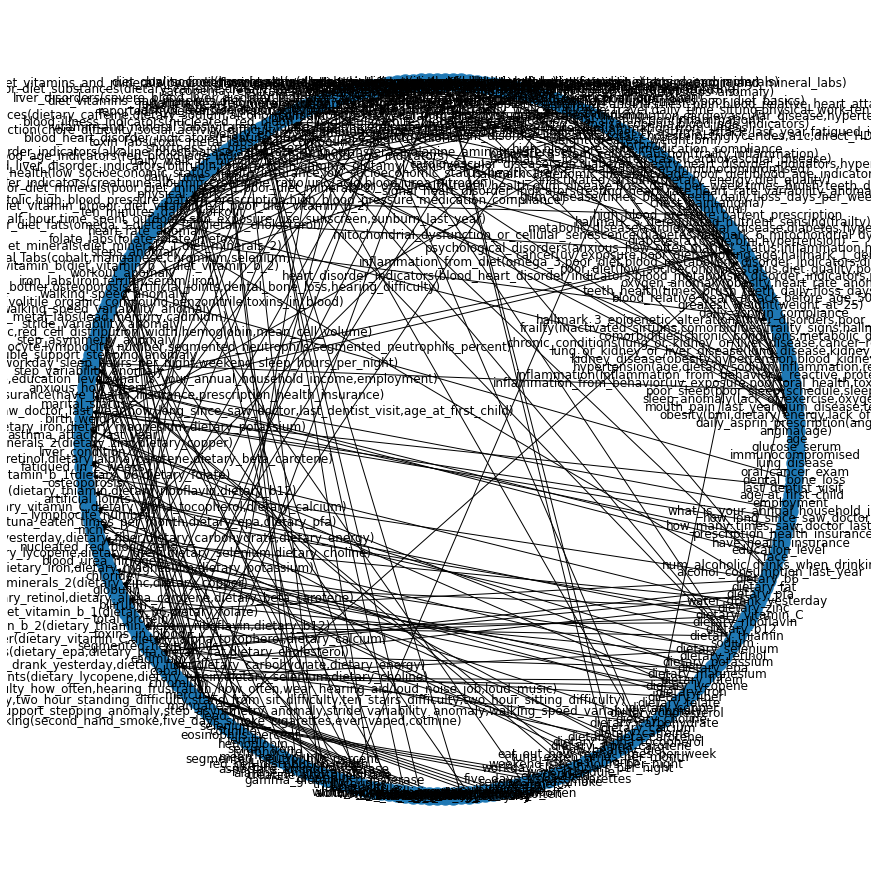

In [15]:
import matplotlib.pyplot as plt
plt.figure(3,figsize=(12,12)) 
#nx.draw(G, with_labels=True)  
#nx.draw_random(G, with_labels=True)   
nx.draw_circular(G, with_labels=True)  
#nx.draw_spectral(G, with_labels=True)   
#nx.draw_spring(G, with_labels=True)  

Here is the description of the Bayesian network in protobuf that we just created with the running of the python file.  The "leaves" have initial probabilities (DiscreteDistribution), and the conditional probabilities (ConditionalProbabilityTable) are to be computed:

In [16]:
bayesianNetwork

discreteDistributions {
  name: "age"
  variables {
    name: "elderly"
    probability: 0.05000000074505806
  }
  variables {
    name: "adult"
    probability: 0.25
  }
  variables {
    name: "young_adult"
    probability: 0.30000001192092896
  }
  variables {
    name: "teen"
    probability: 0.20000000298023224
  }
  variables {
    name: "child"
    probability: 0.20000000298023224
  }
}
discreteDistributions {
  name: "daily_aspirin_compliance"
  variables {
    name: "daily_aspirin_compliance_no"
    probability: 0.30000001192092896
  }
  variables {
    name: "daily_aspirin_compliance_yes"
    probability: 0.699999988079071
  }
}
discreteDistributions {
  name: "high_blood_pressure_patient_prescription"
  variables {
    name: "high_blood_pressure_patient_prescription_yes"
    probability: 0.15000000596046448
  }
  variables {
    name: "high_blood_pressure_patient_prescription_no"
    probability: 0.8500000238418579
  }
}
discreteDistributions {
  name: "high_blood_pressure_m

Here is the Pomegranate net we just made with the description.  Here we compile the net so we can compute probabilities with it.

In [17]:
from sn_bayes.utils import bayesInitialize
longevity = bayesInitialize(bayesianNetwork)

In [18]:
longevity.bake()

We we call a Pomegranate routine that shows the computed probabilities of every variable.  We have made our own utility that pulls out particular variables.

In [19]:
longevity.predict_proba({}) 

array([{
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "elderly" : 0.04998942853284814,
            "adult" : 0.24998266989804976,
            "young_adult" : 0.3000247094498082,
            "teen" : 0.19999935919597506,
            "child" : 0.2000038329233188
        }
    ],
    "frozen" : false
},
       {
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "daily_aspirin_compliance_no" : 0.3000008357349413,
            "daily_aspirin_compliance_yes" : 0.6999991642650587
        }
    ],
    "frozen" : false
},
       {
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "high_blood_pressure_patient_prescription_yes" : 0.14999121560866036,
            "high_blood_pressure_patient_prescription_no" : 0.8500087843913396
        }
    ],
    "froz

## Testing the Bayesian Network

Here we use our query util to enter patient states as evidence (evidence), and then see the probabilities of particular variables we are interested in (outvars), in this case, the output variables.    The query function needs the compiled Pomegranate Bayesian network as well as the description of the network.  In the following examples, we enter a particular patients state , one question at a time, to get a continual change in probability of all states.Adding more risk factors increases risk more.  

In [20]:
import sn_bayes
from sn_bayes.utils import query
evidence = {}
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.8999728358879675,
  'hallmark_1_genomic_instability': 0.10002716411203247},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3795793168700808,
  'no_hallmark_2_telomere_attrition': 0.6204206831299192},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.19160297646459806,
  'no_hallmark_3_epigenetic_alterations': 0.8083970235354019},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.1098902657704881,
  'no_hallmark_4_loss_of_proteostasis': 0.890109734229512},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.8497866351647618,
  'hallmark_5_deregulated_nutrient_sensing': 0.15021336483523814},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.9299937449223311,
  'hallmark_6_mitochondrial_dysfunction': 0.07000625507766886},
 'hallmark_7_cellular_senescence': {'hallma

In [21]:
evidence["low_socioeconomic_status"]= "low_socioeconomic_status"
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.8047214476835799,
  'hallmark_1_genomic_instability': 0.1952785523164201},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3795786957982168,
  'no_hallmark_2_telomere_attrition': 0.6204213042017832},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.20250178065571103,
  'no_hallmark_3_epigenetic_alterations': 0.797498219344289},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.11057092674957014,
  'no_hallmark_4_loss_of_proteostasis': 0.8894290732504297},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.8061915186073548,
  'hallmark_5_deregulated_nutrient_sensing': 0.19380848139264523},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.9092356831581508,
  'hallmark_6_mitochondrial_dysfunction': 0.09076431684184914},
 'hallmark_7_cellular_senescence': {'hallma

### Tests of increasingly poor patient state, showing gradual change of hallmarks

Below we test the bayesian net through the internal query, as it is done for efficiency in the app.  Note the internal query sends back all states not just the requested ones.  We also use query, so that we can see the results clearly in this notbook.    If most persons are of low socioeconomic status to begin with (65% in Nhanes data), then that would explain why the values only went up slightly even though the relative risk of poor diet given low socioeconomic status is 2.66.

In [22]:
import sn_bayes
from sn_bayes.utils import internal_query
evidence = {}
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.61 s, sys: 12 ms, total: 8.62 s
Wall time: 8.61 s


{'angina': {'angina_yes': 0.02999765111694441,
  'angina_no': 0.9700023488830556},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999975968413714,
  'daily_asprin_prescription_no': 0.9500002403158628},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8699998558290035,
  'blood_relative_heart_attack_before_50_yes': 0.13000014417099648},
 'chest_pain': {'chest_pain_yes': 0.2999994576572148,
  'chest_pain_no': 0.7000005423427851},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000009768788,
  'greatest_weight_above_230.00': 0.24999999902312117},
 'weight': {'no_weight_above_92.60': 0.7500035586827866,
  'weight_above_92.60': 0.24999644131721346},
 'height': {'height_above_173.40': 0.24999402800988682,
  'no_height_above_173.40': 0.7500059719901131},
 'hip': {'hip_above_112.70': 0.24999343021940496,
  'no_hip_above_112.70': 0.750006569780595},
 'waist': {'no_waist_above_109.00': 0.7500033971354563,
  'waist_abo

In [23]:
evidence["low_socioeconomic_status"]= "low_socioeconomic_status"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.02999791752378349,
  'angina_no': 0.9700020824762166},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999980616665339,
  'daily_asprin_prescription_no': 0.9500001938333467},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8699998252226233,
  'blood_relative_heart_attack_before_50_yes': 0.13000017477737663},
 'chest_pain': {'chest_pain_yes': 0.2999996023293187,
  'chest_pain_no': 0.7000003976706812},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000009768785,
  'greatest_weight_above_230.00': 0.24999999902312162},
 'weight': {'no_weight_above_92.60': 0.7500035193020483,
  'weight_above_92.60': 0.24999648069795172},
 'height': {'height_above_173.40': 0.24999409380825857,
  'no_height_above_173.40': 0.7500059061917415},
 'hip': {'hip_above_112.70': 0.24999350297658504,
  'no_hip_above_112.70': 0.7500064970234149},
 'waist': {'no_waist_above_109.00': 0.7500033594576307,
  'waist_ab

 Below we see that frailty affects the hallmarks more strongly, including increases in hallmark 3, while 8 and 5 are actually flipped on.  When cancer is added,  hallmarks 7 and 9 flip on.

In [24]:
evidence = {}
evidence["frailty"] = "frailty"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.04289749541549565,
  'angina_no': 0.9571025045845043},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05228386589499234,
  'daily_asprin_prescription_no': 0.9477161341050077},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8684351077002591,
  'blood_relative_heart_attack_before_50_yes': 0.1315648922997408},
 'chest_pain': {'chest_pain_yes': 0.30715401812226406,
  'chest_pain_no': 0.6928459818777358},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000007460063,
  'greatest_weight_above_230.00': 0.24999999925399374},
 'weight': {'no_weight_above_92.60': 0.727305380561833,
  'weight_above_92.60': 0.2726946194381671},
 'height': {'height_above_173.40': 0.28775614031044877,
  'no_height_above_173.40': 0.7122438596895512},
 'hip': {'hip_above_112.70': 0.29194798513960946,
  'no_hip_above_112.70': 0.7080520148603906},
 'waist': {'no_waist_above_109.00': 0.7282769310020611,
  'waist_abov

In [25]:
evidence["cancer"] = "cancer"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.04130685588967577,
  'angina_no': 0.9586931441103244},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.052024312686954136,
  'daily_asprin_prescription_no': 0.9479756873130458},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8685760695439845,
  'blood_relative_heart_attack_before_50_yes': 0.13142393045601553},
 'chest_pain': {'chest_pain_yes': 0.30636313385535574,
  'chest_pain_no': 0.6936368661446443},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000008158032,
  'greatest_weight_above_230.00': 0.24999999918419674},
 'weight': {'no_weight_above_92.60': 0.7342424173185442,
  'weight_above_92.60': 0.2657575826814559},
 'height': {'height_above_173.40': 0.27625534421920767,
  'no_height_above_173.40': 0.7237446557807924},
 'hip': {'hip_above_112.70': 0.27914568039162063,
  'no_hip_above_112.70': 0.7208543196083794},
 'waist': {'no_waist_above_109.00': 0.7349066960313263,
  'waist_a

In [26]:
#we show some of the same results as in the last cell for clarity
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.5331921371995143,
  'hallmark_1_genomic_instability': 0.46680786280048564},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.4431042917895359,
  'no_hallmark_2_telomere_attrition': 0.5568957082104642},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.41120611328934376,
  'no_hallmark_3_epigenetic_alterations': 0.5887938867106562},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.3332722565904506,
  'no_hallmark_4_loss_of_proteostasis': 0.6667277434095495},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.0,
  'hallmark_5_deregulated_nutrient_sensing': 1.0},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.8565836418434748,
  'hallmark_6_mitochondrial_dysfunction': 0.14341635815652506},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 1.0

## Testing Explanations

The explain function will tell you which nodes, whether inner or leaf, when changed, change the output variable.  A variable is on the reverse explain list if we want to know what changes to other variables will increase it.  Otherwise we look to 
changes that decrease the variable to be explained.  One may select which explanations are relevant for their purposes, as this is just a measure of dependence. The point is to find out which variables help a situation, where the output variables are the goals.  At default values,  we want to find out how to decrease an output_variables probability, when we move a variable from where it is to one value to the right.  Our present rules, in longevity_bayes.py, are designed so that one value to the right is an improvement.  The explanation output tells you the change in the probability of the output variable when this happens.  Those explanations with the greatest values tell the variables that when you improve them decrease the probability of the output variable the most, and are thus the most helpful in decreasing the chance of a bad thing.  However, some variables could possibly need to additionally be on the reverse_explain_list because they are not bad things, they are good things, so as a goal, you would want to know how to increase their probability not decrease it.  So, to find an explanation for why an indicator is so good, you have to enter all the nodes of the net into reverse_evidence that were not in reverse_evidence when explainng why an indicator is doing poorly.

Although we need the explain function for complex rule sets in which the direction of the rules  changes at times because there are different and multiple goals, we have made two wrapper functions that only apply for rulesets in which all the rules are in the same direction, for example the covid ruleset and the longevity ruleset.  One wrapper is explain_why_bad, which takes on the default of the explain function, and has no reverse_explain_list or reverse_evidence.  The other is explain_why_good, explained below.  explain_why_good (and explain using reverse evidence and explain vars only works when the result is actually good, and explain_why_bad (and the explain default) only works when a result is actually bad.  Below we show only the explain why good and explain why bad functions for explanations, because the longevity_bayes.py file only has rules that are expressed as negative states.

In [27]:
#include_list = ["heart_rate_variability_anomaly","oxygen_anomaly","lack_of_exercise","uv_exposure","blood_age_indicators","poor_sleep","inflammation_from_behavior","poor_diet","smoking","frailty_signals","cancer","frailty","liver_disorders","cardiovascular_disease","inactivated_sirtuins","inflammation","sarcopenia","comorbidities","general_aging_signs","blood_metabolism_disorder_indicators","obesity","hypertension","diabetes","metabolic_disease","gender"]


In [28]:
include_list = ["anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cancer_related","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]

In [29]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 16.310020718723536 seconds


### Explanations

To pull out explanations, the algorithm has changed as a result of the new less computationally complex algorithm.  First, find the majority explanation value for an output variable, and then get rid of all candidate explanations that have that value or below. Then, of the remaining, use a threshold of 0.1 and above to include an explanation.  Then you can rank them by the magnitude, to find the stronger explanations, perhaps to show those nearer to the top.  Below, for example, we have preinted out the why bad, and then the why good. Typically if the results are good, and you ask why they are bad, you will not get an answer and visa versa.  We see that cancer is an explaination fo rwhy hallmark 7 and 9 are bad, and frailty explains 8 and 5.   



In [30]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'frailty': -0.18978405907978013, 'cancer': -0.18978405907978013, 'lack_of_exercise_reported': 0.060215872444947305, 'blood_metabolism_disorder_indicators': -0.18978405907978013, 'uv_exposure': -0.18978406012751758, 'blood_age_indicators': -0.18978405907978013, 'diet_vitamins_and_minerals': -0.18978405907978013, 'diet_fats': -0.18978405907978013, 'diet_basics': -0.18978405907978013, 'diet_quality_food': -0.18978405907978013, 'diet_quantity': -0.18978405907978013, 'diet_quality': -0.18978405907978013, 'general_aging_signs': -0.18978405907978013, 'inactivated_sirtuins': -0.18978405907978013, 'lung_or_kidney_or_liver_disease': -0.18978405907978013, 'frailty_signs': -0.18978405907978013, 'cancer_related': -0.18978405907978013, 'chronic_conditions': -0.18978405907978013, 'comorbidities': -0.18978405907978013}, 'obesity': {'frailty': 0.02260430706510691, 'cancer': 0.02260430706510691, 'lack_of_exercise_reported': 0.02260430706510691, 'lack_of_exercise': 0.010407123718556

In [31]:
evidence = {}
evidence1 = evidence.copy()
evidence1['a1c']=  'a1c_diabetes_5.7_and_above'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 9.31 s, sys: 8 ms, total: 9.32 s
Wall time: 9.32 s


{'angina': {'angina_yes': 0.02999777347790636,
  'angina_no': 0.9700022265220936},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999973954413327,
  'daily_asprin_prescription_no': 0.9500002604558667},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8699999421319293,
  'blood_relative_heart_attack_before_50_yes': 0.1300000578680707},
 'chest_pain': {'chest_pain_yes': 0.2999993452583591,
  'chest_pain_no': 0.700000654741641},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000009768631,
  'greatest_weight_above_230.00': 0.24999999902313683},
 'weight': {'no_weight_above_92.60': 0.7500025482997724,
  'weight_above_92.60': 0.24999745170022755},
 'height': {'height_above_173.40': 0.24999554825103054,
  'no_height_above_173.40': 0.7500044517489695},
 'hip': {'hip_above_112.70': 0.24999518857306005,
  'no_hip_above_112.70': 0.75000481142694},
 'waist': {'no_waist_above_109.00': 0.7500024865594483,
  'waist_above_

### Realistic survey answers

The above example is simple for understanding's sake, it just has 2 inputs, one of which is in the questions (cancer) and one which is not, but is affected by the questions that are inputs (frailty).  So next we will have the input that is more like the answers to the surveys, and see if they still produce correct results

In [32]:
evidence = {"age":"adult",
"daily_aspirin_compliance":"daily_aspirin_compliance_yes",
"high_blood_pressure_patient_prescription":"high_blood_pressure_patient_prescription_no",
"high_blood_pressure_medication_compliance":"high_blood_pressure_medication_compliance_yes",
"diastolic":"diastolic_80_to_89_high_stage_1",
"systolic":"systolic_less_than_120_normal",
"sun_exposure_half_hour":"sun_exposure_half_hour_mild_burn_tanning",
"time_spent_outdoors":"time_spent_outdoors_none",
"sun_exposure_use_sunscreen":"sun_exposure_use_sunscreen_sometimes",
"sunburn_last_year":"sunburn_last_year_yes",
"weight_at_25":"weight_at_25_above_125.00_to_150.00_and_below",
"bmi":"bmi_over_40_high_risk",
"dietary_energy":"dietary_energy_above_2612.00_to_3939.00_and_below",
"shortness_of_breath_exertion":"shortness_of_breath_exertion_yes",
"daily_walk_or_bicycle_travel":"daily_walk_or_bicycle_travel_less_than_30_minutes",
"daily_time_sitting":"daily_time_sitting_12_or_more_hours",
"physical_work":"physical_work_no",
"ten_minutes_daily_workout":"ten_minutes_daily_workout_no",
"heart_rate_anomaly":"heart_rate_anomaly",
"steps_anomaly":"steps_anomaly",
"workout_anomaly":"workout_anomaly",
"walking_speed_anomaly":"walking_speed_anomaly",
"walking_speed_variability_anomaly":"walking_speed_variability_anomaly",
"stride_variability_anomaly":"no_stride_variability_anomaly",
"step_asymmetry_anomaly":"no_step_asymmetry_anomaly",
"double_support_stepping_anomaly":"double_support_stepping__anomaly",
"step_variability_anomaly":"step_variability_anomaly",
"anxious_how_often":"anxious_daily",
"marital_status":"divorced",
"asthma_attack_last_year":"asthma_attack_last_year_no",
"liver_condition":"liver_condition_yes",
"fatiqued_in_2_weeks":"fatiqued_in_2_weeks_nearly_everyday",
"osteoporosis":"osteoporosis_no",
"artificial_joints":"artificial_joints_no",
"work_limiting_problem":"work_limiting_problem_yes",
"ten_stairs_difficulty":"ten_stairs_difficulty_some",
"chore_difficulty":"chore_difficulty_some",
"walking_difficulty":"walking_difficulty_much",
"stand_from_sit_difficulty":"stand_from_sit_difficulty_much",
"two_hour_standing_difficulty":"two_hour_standing_difficulty_much",
"two_hour_sitting_difficulty":"two_hour_sitting_difficulty_none",
"social_activity_difficulty":"social_activity_difficulty_much",
"urine_leakage_bother":"urine_leakage_bother_somewhat",
"hearing_difficulty_how_often":"hearing_difficulty_usually",
"hearing_frustration_how_often":"hearing_frustration_usually",
"wear_hearing_aid":"wear_hearing_aid_no",
"loud_noise_job":"loud_noise_job_no",
"loud_music":"loud_music_yes",
"second_hand_smoke":"second_hand_smoke_no",
"five_days_smoke_cigarettes":"five_days_smoke_cigarettes_no",
"ever_vaped":"ever_vaped_no",
"gender":"female",
"work_schedule":"work_schedule_evenings_or_nights",
"workday_sleep_hours_per_night":"workday_sleep_under_5",
"weekend_sleep_hours_per_night":"weekend_sleep_5.0_to_6.5",
"fish_last_month":"fish_last_month_no",
"tuna_eaten_times_per_month":"tuna_eaten_per_month_0_or_1",
"eat_out_how_many_times_per_week":"eat_out_more_than_7_times_per_week",
"how_healthy_diet":"how_healthy_diet_fair",
"alcohol_consumption_last_year":"alcohol_never",
"race":"race_white",
"education_level":"education_level_at_least_some_college",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes",
"how_many_times_saw_doctor_last_year":"saw_doctor_1_or_2_times_last_year",
"how_long_since_saw_doctor":"saw_doctor_less_than_6_months_ago",
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working",
"age_at_first_child":"age_at_first_child_20_through_24",
"last_dentist_visit":"last_dentist_visit_6_months_or_less",
"dental_bone_loss":"dental_bone_loss_no",
"oral_cancer_exam":"oral_cancer_exam_no",
"lung_disease":"no_lung_disease",
"immunocompromised":"not_immunocompromised",
"angina":"angina_no",
"daily_asprin_prescription":"daily_asprin_prescription_no",
"blood_relative_heart_attack_before_age_50":"blood_relative_heart_attack_before_50_no",
"chest_pain":"chest_pain_no",
"greatest_weight":"greatest_weight_above_230.00",
"weight":"weight_above_92.60",
"height":"no_height_above_173.40",
"lack_of_exercise_reported":"lack_of_exercise_reported",
"salt_how_often":"salt_very_often",
"times_brush_teeth_daily":"no_times_brush_teeth_daily_1_or_less",
"floss_days_per_week":"no_floss_days_per_week_3_or_less",
"teeth_health":"teeth_health_poor",
"gum_disease":"gum_disease_yes",
"mouth_pain_last_year":"mouth_pain_last_year_fairly_often",
"sleep_anomaly":"sleep_anomaly"}

In [33]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.66 s, sys: 3 µs, total: 8.66 s
Wall time: 8.66 s


{'hip': {'hip_above_112.70': 0.7500022081658078,
  'no_hip_above_112.70': 0.24999779183419216},
 'waist': {'no_waist_above_109.00': 0.4910702776895554,
  'waist_above_109.00': 0.5089297223104446},
 'lack_of_exercise_signal': {'no_lack_of_exercise_signal': 0.0,
  'lack_of_exercise_signal': 1.0},
 'lack_of_exercise': {'no_lack_of_exercise': 0.0, 'lack_of_exercise': 1.0},
 'obesity': {'no_obesity': 0.042761193791976876,
  'obesity': 0.9572388062080232},
 'total_cholesterol': {'total_cholesterol_high_above_200': 0.29999105283170735,
  'no_total_cholesterol_high_above_200': 0.7000089471682927},
 'dietary_sodium': {'no_dietary_sodium_above_4297.00': 0.404559186288626,
  'dietary_sodium_above_4297.00': 0.595440813711374},
 'fasting_glucose': {'no_fasting_glucose_high_above_100': 0.5700062586316007,
  'fasting_glucose_high_above_100': 0.42999374136839935},
 'a1c': {'no_a1c_diabetes_5.7_and_above': 0.6700114099135923,
  'a1c_diabetes_5.7_and_above': 0.3299885900864078},
 'heart_rate_variability

In [34]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.8542057741061937,
  'hallmark_1_genomic_instability': 0.1457942258938063},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.35032950727172396,
  'no_hallmark_2_telomere_attrition': 0.649670492728276},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.49316404791889784,
  'no_hallmark_3_epigenetic_alterations': 0.5068359520811021},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.2712748069531849,
  'no_hallmark_4_loss_of_proteostasis': 0.7287251930468152},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.6801567462856302,
  'hallmark_5_deregulated_nutrient_sensing': 0.3198432537143698},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.8433684202795154,
  'hallmark_6_mitochondrial_dysfunction': 0.15663157972048447},
 'hallmark_7_cellular_senescence': {'hallmar

In [35]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 20.31673344038427 seconds


In [36]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'daily_walk_or_bicycle_travel': 0.0, 'daily_time_sitting': 0.0, 'ten_minutes_daily_workout': 0.0, 'heart_rate_anomaly': 0.0, 'steps_anomaly': 0.0, 'workout_anomaly': 0.0, 'step_variability_anomaly': 0.0, 'anxious_how_often': 0.0, 'marital_status': 0.0, 'eat_out_how_many_times_per_week': 0.0, 'lack_of_exercise_reported': 0.06455429529394607, 'sleep_anomaly': 0.0, 'obesity': 0.0, 'blood_metabolism_disorder_indicators': 0.0, 'liver_disorders': 0.0, 'uv_exposure': 0.0, 'blood_age_indicators': 0.0, 'poor_oral_health': 0.0, 'inflammation_from_illness': 0.0, 'c_reactive_protein': 0.0, 'poor_sleep_schedule': 0.0, 'poor_sleep': 0.0, 'inflammation_from_behavior': 0.0, 'diet_vitamins_and_minerals': 0.0, 'diet_fats': 0.0, 'diet_basics': 0.0, 'diet_quality_food': 0.0, 'diet_quantity': 0.0, 'diet_quality': 0.0, 'hypertension': 0.0, 'general_aging_signs': 0.0, 'frailty_signals': 0.0, 'inactivated_sirtuins': 0.0, 'lung_or_kidney_or_liver_disease': 0.0, 'frailty_signs': 0.0, 'chro

## One by One Survey Example (Apple Health + Apple Watch)

In [37]:
include_list = ["dietary_energy", "bmi", "lack_of_exercise","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cancer_related","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]



In [38]:
#first, biometric survey                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         
evidence = {"age":"adult",
"gender":"female",
"weight":"weight_above_92.60",
"height":"no_height_above_173.40",
"bmi":"bmi_over_40_high_risk",
'resting_heart_rate':'no_resting_heart_rate_very_high_91_and_above',
"systolic":"systolic_130_to_139_high_stage_1",
"diastolic":"diastolic_80_to_89_high_stage_1"}
            

In [39]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 9.25 s, sys: 16 ms, total: 9.27 s
Wall time: 9.26 s


{'angina': {'angina_yes': 0.10684715310616576,
  'angina_no': 0.8931528468938342},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.06380013824141018,
  'daily_asprin_prescription_no': 0.9361998617585898},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8602233368029225,
  'blood_relative_heart_attack_before_50_yes': 0.1397766631970774},
 'chest_pain': {'chest_pain_yes': 0.3434212490017218,
  'chest_pain_no': 0.6565787509982783},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.5850739936418469,
  'greatest_weight_above_230.00': 0.41492600635815324},
 'hip': {'hip_above_112.70': 0.7500022081658078,
  'no_hip_above_112.70': 0.24999779183419216},
 'waist': {'no_waist_above_109.00': 0.4910702776895554,
  'waist_above_109.00': 0.5089297223104446},
 'lack_of_exercise_reported': {'no_lack_of_exercise_reported': 0.5017415068862598,
  'lack_of_exercise_reported': 0.4982584931137401},
 'lack_of_exercise_signal': {'no_lack_of

In [40]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.8118010161877693,
  'hallmark_1_genomic_instability': 0.18819898381223066},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3843860151162361,
  'no_hallmark_2_telomere_attrition': 0.6156139848837638},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.22201893104890416,
  'no_hallmark_3_epigenetic_alterations': 0.7779810689510959},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.2841572427891406,
  'no_hallmark_4_loss_of_proteostasis': 0.7158427572108593},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.7268950140109556,
  'hallmark_5_deregulated_nutrient_sensing': 0.2731049859890445},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.9283446502007037,
  'hallmark_6_mitochondrial_dysfunction': 0.07165534979929643},
 'hallmark_7_cellular_senescence': {'hallma

In [41]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.066399570554495 seconds


In [42]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.1496614033506598, 'obesity': -0.10004069609436173, 'blood_metabolism_disorder_indicators': -0.1496614023616325, 'blood_age_indicators': -0.1496614023616325, 'diet_vitamins_and_minerals': -0.1496614023616325, 'diet_fats': -0.1496614023616325, 'diet_basics': -0.1496614023616325, 'diet_quality_food': -0.1496614023616325, 'diet_quantity': -0.1496614023616325, 'diet_quality': -0.1496614023616325, 'general_aging_signs': -0.1496614023616325, 'inactivated_sirtuins': -0.1496614023616325, 'lung_or_kidney_or_liver_disease': -0.1496614023616325, 'frailty_signs': -0.1496614023616325, 'chronic_conditions': -0.1496614023616325, 'comorbidities': -0.1496614023616325}, 'obesity': {'bmi': 0.7436390058495718, 'lack_of_exercise': -0.005217405803603192, 'blood_metabolism_disorder_indicators': -0.01597872060432226, 'blood_age_indicators': -0.01597872060432226, 'diet_vitamins_and_minerals': -0.01597872060432226, 'diet_fats': -0.01597872060432226, 'diet_basics': -0.0159787206043

In [43]:
#add daily checkin
evidence.update(
    {
"workday_sleep_hours_per_night":"workday_sleep_under_5",
"water_drank_yesterday":"water_drank_yesterday_above_870.00_to_1633.50_and_below",
"dietary_energy":"dietary_energy_above_2612.00_to_3939.00_and_below" ,
"daily_walk_or_bicycle_travel":"daily_walk_or_bicycle_travel_less_than_30_minutes",
"daily_time_sitting":"daily_time_sitting_12_or_more_hours" ,         
"ten_minutes_daily_workout":"ten_minutes_daily_workout_no"
    }
)

In [44]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.61 s, sys: 3.99 ms, total: 8.61 s
Wall time: 8.61 s


{'angina': {'angina_yes': 0.10684713674582291,
  'angina_no': 0.8931528632541771},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.06380013011480229,
  'daily_asprin_prescription_no': 0.9361998698851978},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8602233497552616,
  'blood_relative_heart_attack_before_50_yes': 0.1397766502447384},
 'chest_pain': {'chest_pain_yes': 0.34342122189655405,
  'chest_pain_no': 0.6565787781034459},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.5850739936418469,
  'greatest_weight_above_230.00': 0.41492600635815324},
 'hip': {'hip_above_112.70': 0.7500022081658078,
  'no_hip_above_112.70': 0.24999779183419216},
 'waist': {'no_waist_above_109.00': 0.4910702776895554,
  'waist_above_109.00': 0.5089297223104446},
 'lack_of_exercise_reported': {'no_lack_of_exercise_reported': 0.1939148634416173,
  'lack_of_exercise_reported': 0.8060851365583827},
 'lack_of_exercise_signal': {'no_lack_o

In [45]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.8116002044777781,
  'hallmark_1_genomic_instability': 0.18839979552222186},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.4050401334610871,
  'no_hallmark_2_telomere_attrition': 0.594959866538913},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.29947321755678646,
  'no_hallmark_3_epigenetic_alterations': 0.7005267824432136},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.2948578523265787,
  'no_hallmark_4_loss_of_proteostasis': 0.7051421476734213},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.6965893402251334,
  'hallmark_5_deregulated_nutrient_sensing': 0.3034106597748666},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.9118708677229311,
  'hallmark_6_mitochondrial_dysfunction': 0.08812913227706887},
 'hallmark_7_cellular_senescence': {'hallmar

In [46]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.450457021594048 seconds


In [47]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.14487465410287248, 'dietary_energy': 0.14487466069638733, 'daily_walk_or_bicycle_travel': 0.14487465410287215, 'daily_time_sitting': 0.14487465410287215, 'ten_minutes_daily_workout': 0.14487465410287215, 'lack_of_exercise_reported': 0.4112969647566594, 'obesity': 0.22878724791768112, 'blood_metabolism_disorder_indicators': 0.14487465410287215, 'blood_age_indicators': 0.14487465410287215, 'poor_sleep_schedule': 0.14487465410287215, 'poor_sleep': 0.14487465286658818, 'diet_vitamins_and_minerals': 0.14487465410287215, 'diet_fats': 0.14487465410287215, 'diet_basics': 0.14487465410287215, 'diet_quality_food': 0.14487465410287215, 'diet_quantity': 0.14487465410287215, 'diet_quality': 0.14487465410287215, 'general_aging_signs': 0.14487465410287215, 'inactivated_sirtuins': 0.14487465410287215, 'lung_or_kidney_or_liver_disease': 0.14487465410287215, 'chronic_conditions': 0.14487465410287215, 'comorbidities': 0.14487465410287215}, 'obesity': {'bmi': 0.7663859662797

In [48]:
#add demographic survey
evidence.update(
    {
"race":"race_white",
"marital_status":"divorced",
"education_level":"education_level_at_least_some_college" ,
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working" ,       
"work_schedule":"work_schedule_variable",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes"
    }
)

In [49]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.58 s, sys: 8 ms, total: 8.58 s
Wall time: 8.58 s


{'angina': {'angina_yes': 0.10684713714165676,
  'angina_no': 0.8931528628583432},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.06380013031142323,
  'daily_asprin_prescription_no': 0.9361998696885768},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8602233494418835,
  'blood_relative_heart_attack_before_50_yes': 0.13977665055811656},
 'chest_pain': {'chest_pain_yes': 0.3434212225523559,
  'chest_pain_no': 0.656578777447644},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.5850739936418469,
  'greatest_weight_above_230.00': 0.41492600635815324},
 'hip': {'hip_above_112.70': 0.7500022081658078,
  'no_hip_above_112.70': 0.24999779183419216},
 'waist': {'no_waist_above_109.00': 0.4910702776895554,
  'waist_above_109.00': 0.5089297223104446},
 'lack_of_exercise_reported': {'no_lack_of_exercise_reported': 0.1939148832274376,
  'lack_of_exercise_reported': 0.8060851167725623},
 'lack_of_exercise_signal': {'no_lack_of

In [50]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.8634932757246592,
  'hallmark_1_genomic_instability': 0.13650672427534075},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.40504035590137344,
  'no_hallmark_2_telomere_attrition': 0.5949596440986266},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.3327721224963532,
  'no_hallmark_3_epigenetic_alterations': 0.6672278775036468},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.2947750819237856,
  'no_hallmark_4_loss_of_proteostasis': 0.7052249180762143},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.7209098705549085,
  'hallmark_5_deregulated_nutrient_sensing': 0.2790901294450915},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.9156933743128153,
  'hallmark_6_mitochondrial_dysfunction': 0.08430662568718465},
 'hallmark_7_cellular_senescence': {'hallma

In [51]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 19.094178661704063 seconds


In [52]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.14487463411154733, 'dietary_energy': 0.14487464070506217, 'daily_walk_or_bicycle_travel': 0.144874634111547, 'daily_time_sitting': 0.144874634111547, 'ten_minutes_daily_workout': 0.144874634111547, 'marital_status': 0.144874634111547, 'lack_of_exercise_reported': 0.41129694476533424, 'obesity': 0.22878722792635597, 'blood_metabolism_disorder_indicators': 0.144874634111547, 'blood_age_indicators': 0.144874634111547, 'poor_sleep_schedule': 0.144874634111547, 'poor_sleep': 0.14487463287526303, 'diet_vitamins_and_minerals': 0.144874634111547, 'diet_fats': 0.144874634111547, 'diet_basics': 0.144874634111547, 'diet_quality_food': 0.144874634111547, 'diet_quantity': 0.144874634111547, 'diet_quality': 0.144874634111547, 'general_aging_signs': 0.144874634111547, 'inactivated_sirtuins': 0.144874634111547, 'lung_or_kidney_or_liver_disease': 0.144874634111547, 'chronic_conditions': 0.144874634111547, 'comorbidities': 0.144874634111547}, 'obesity': {'bmi': 0.766385961

In [53]:
#add demographic survey
evidence.update(
    {
"race":"race_white",
"marital_status":"divorced",
"education_level":"education_level_at_least_some_college" ,
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working" ,       
"work_schedule":"work_schedule_variable",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes"
    }
)

In [54]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.58 s, sys: 4 ms, total: 8.58 s
Wall time: 8.58 s


{'angina': {'angina_yes': 0.10684713714165676,
  'angina_no': 0.8931528628583432},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.06380013031142323,
  'daily_asprin_prescription_no': 0.9361998696885768},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8602233494418835,
  'blood_relative_heart_attack_before_50_yes': 0.13977665055811656},
 'chest_pain': {'chest_pain_yes': 0.3434212225523559,
  'chest_pain_no': 0.656578777447644},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.5850739936418469,
  'greatest_weight_above_230.00': 0.41492600635815324},
 'hip': {'hip_above_112.70': 0.7500022081658078,
  'no_hip_above_112.70': 0.24999779183419216},
 'waist': {'no_waist_above_109.00': 0.4910702776895554,
  'waist_above_109.00': 0.5089297223104446},
 'lack_of_exercise_reported': {'no_lack_of_exercise_reported': 0.1939148832274376,
  'lack_of_exercise_reported': 0.8060851167725623},
 'lack_of_exercise_signal': {'no_lack_of

In [55]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.8634932757246592,
  'hallmark_1_genomic_instability': 0.13650672427534075},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.40504035590137344,
  'no_hallmark_2_telomere_attrition': 0.5949596440986266},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.3327721224963532,
  'no_hallmark_3_epigenetic_alterations': 0.6672278775036468},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.2947750819237856,
  'no_hallmark_4_loss_of_proteostasis': 0.7052249180762143},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.7209098705549085,
  'hallmark_5_deregulated_nutrient_sensing': 0.2790901294450915},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.9156933743128153,
  'hallmark_6_mitochondrial_dysfunction': 0.08430662568718465},
 'hallmark_7_cellular_senescence': {'hallma

In [56]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 19.06428582407534 seconds


In [57]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.14487463411154733, 'dietary_energy': 0.14487464070506217, 'daily_walk_or_bicycle_travel': 0.144874634111547, 'daily_time_sitting': 0.144874634111547, 'ten_minutes_daily_workout': 0.144874634111547, 'marital_status': 0.144874634111547, 'lack_of_exercise_reported': 0.41129694476533424, 'obesity': 0.22878722792635597, 'blood_metabolism_disorder_indicators': 0.144874634111547, 'blood_age_indicators': 0.144874634111547, 'poor_sleep_schedule': 0.144874634111547, 'poor_sleep': 0.14487463287526303, 'diet_vitamins_and_minerals': 0.144874634111547, 'diet_fats': 0.144874634111547, 'diet_basics': 0.144874634111547, 'diet_quality_food': 0.144874634111547, 'diet_quantity': 0.144874634111547, 'diet_quality': 0.144874634111547, 'general_aging_signs': 0.144874634111547, 'inactivated_sirtuins': 0.144874634111547, 'lung_or_kidney_or_liver_disease': 0.144874634111547, 'chronic_conditions': 0.144874634111547, 'comorbidities': 0.144874634111547}, 'obesity': {'bmi': 0.766385961

In [58]:
#add general medical history survey
evidence.update(
    {
        "how_long_since_saw_doctor":"saw_doctor_6_to_12_months_ago",
        "how_many_times_saw_doctor_last_year":"saw_doctor_1_or_2_times_last_year",
        "birth_weight":"birth_weight_7_to_8_lbs",
        "greatest_weight":"greatest_weight_above_230.00",
        "weight_at_25":"weight_at_25_above_125.00_to_150.00_and_below",
        "daily_asprin_prescription":"daily_asprin_prescription_no",
        "daily_aspirin_compliance":"daily_aspirin_compliance_no",
        "shortness_of_breath_exertion":"shortness_of_breath_exertion_yes",
        "work_limiting_problem":"work_limiting_problem_no",
        "anxious_how_often":"anxious_daily",
        "fatiqued_in_2_weeks":"fatiqued_in_2_weeks_more_than_half_the_days",
        "chest_pain":"chest_pain_no",
        "liver_disorders":"liver_disorders",
        "osteoporosis":"osteoporosis_no",
        "asthma_attack_last_year":"asthma_attack_last_year_no",
        "high_blood_pressure_patient_prescription":"high_blood_pressure_patient_prescription_no",
        "blood_relative_heart_attack_before_age_50":"blood_relative_heart_attack_before_50_no",
        "urine_leakage_bother":"urine_leakage_bother_somewhat",
        "artificial_joints":"artificial_joints_yes",
        "hearing_difficulty_how_often":"hearing_difficulty_usually",
        "hearing_frustration_how_often":"hearing_frustration_usually",
        "wear_hearing_aid":"wear_hearing_aid_no",
        "loud_noise_job":"loud_noise_job_no",
        "loud_music":"loud_music_yes",
        "age_at_first_child":"age_at_first_child_20_through_24",
        "last_dentist_visit":"last_dentist_visit_7_months_to_a_year",
        "times_brush_teeth_daily":"no_times_brush_teeth_daily_1_or_less",
        "floss_days_per_week":"no_floss_days_per_week_3_or_less",
        "teeth_health":"no_teeth_health_poor",
        "gum_disease":"gum_disease_yes",
        "oral_cancer_exam":"oral_cancer_exam_no",
        "dental_bone_loss":"dental_bone_loss_no",
        "mouth_pain_last_year":"mouth_pain_last_year_fairly_often"
        
    }
)

In [59]:

import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 9.02 s, sys: 2 µs, total: 9.02 s
Wall time: 9.01 s


{'angina': {'angina_yes': 0.017283482918332305,
  'angina_no': 0.9827165170816676},
 'hip': {'hip_above_112.70': 0.7500022081658078,
  'no_hip_above_112.70': 0.24999779183419216},
 'waist': {'no_waist_above_109.00': 0.4910702776895554,
  'waist_above_109.00': 0.5089297223104446},
 'lack_of_exercise_reported': {'no_lack_of_exercise_reported': 0.05516841175589721,
  'lack_of_exercise_reported': 0.9448315882441027},
 'lack_of_exercise_signal': {'no_lack_of_exercise_signal': 0.9503764896458863,
  'lack_of_exercise_signal': 0.049623510354113665},
 'lack_of_exercise': {'no_lack_of_exercise': 0.05278648324967279,
  'lack_of_exercise': 0.9472135167503272},
 'obesity': {'no_obesity': 0.05077102527435029, 'obesity': 0.9492289747256497},
 'salt_how_often': {'salt_very_often': 0.17999910294503915,
  'no_salt_very_often': 0.8200008970549607},
 'total_cholesterol': {'total_cholesterol_high_above_200': 0.2999895063520407,
  'no_total_cholesterol_high_above_200': 0.7000104936479593},
 'dietary_sodium'

In [60]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.8681826426049278,
  'hallmark_1_genomic_instability': 0.13181735739507214},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.40599281843523266,
  'no_hallmark_2_telomere_attrition': 0.5940071815647673},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.5236842899165536,
  'no_hallmark_3_epigenetic_alterations': 0.47631571008344653},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.2953788827664427,
  'no_hallmark_4_loss_of_proteostasis': 0.7046211172335574},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.6745607332912842,
  'hallmark_5_deregulated_nutrient_sensing': 0.32543926670871587},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.8835264019143942,
  'hallmark_6_mitochondrial_dysfunction': 0.11647359808560585},
 'hallmark_7_cellular_senescence': {'hall

In [61]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 19.416392216458917 seconds


In [62]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.27763065071759296, 'dietary_energy': 0.2776306573111077, 'daily_walk_or_bicycle_travel': 0.27763065071759263, 'daily_time_sitting': 0.27763065071759263, 'ten_minutes_daily_workout': 0.27763065071759263, 'marital_status': 0.27763065071759263, 'anxious_how_often': 0.27763065071759263, 'liver_disorders': 0.27763065071759263, 'lack_of_exercise_reported': 0.5440529612630829, 'obesity': 0.3615432444127137, 'blood_metabolism_disorder_indicators': 0.27763065071759263, 'blood_age_indicators': 0.27763065071759263, 'poor_oral_health': 0.27763064948130844, 'inflammation_from_illness': 0.27763065071759263, 'c_reactive_protein': 0.27763065071759263, 'poor_sleep_schedule': 0.27763065071759263, 'poor_sleep': 0.27763064948130844, 'inflammation_from_behavior': 0.37256715261642637, 'diet_vitamins_and_minerals': 0.27763065071759263, 'diet_fats': 0.27763065071759263, 'diet_basics': 0.27763065071759263, 'diet_quality_food': 0.27763065071759263, 'diet_quantity': 0.2776306507175

In this example, we see that the values of all of the hallmarks and recommendations are positive.   Therefore, the only insights are from the explanation of why so good. The user is doing well with 3 and 5 because there are no signs of frailty, and 4 because there is no problems with cardiovascular disease, and 6 because there is no problem with inflammation.  Hallmark 7 is good because of a lack of inflammation or cancer, 8 because no inflammation or frailty, and 9 no inflammation or cancer.  Hallmark 10 is good because there is no inflammation, cander, or cardiovascular disease.   There are two health recommendations given.  For explaining why bad, we see that lack of exercise has the explanation that it was reported, and a sleep anomaly explains the need for a poor sleep recommendation.  For explaining why good we see that diet quality and lack of inflammation from diet are why the user does not have problems with a poor diet.  The user is doing good with smoking as the result of reported smoking.


In [63]:
evidence1 = evidence.copy()
evidence1['diabetes']=  'diabetes'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 9.6 s, sys: 1 µs, total: 9.6 s
Wall time: 9.59 s


{'angina': {'angina_yes': 0.0172834650144669, 'angina_no': 0.9827165349855331},
 'hip': {'hip_above_112.70': 0.7500022081658078,
  'no_hip_above_112.70': 0.24999779183419216},
 'waist': {'no_waist_above_109.00': 0.4910702776895554,
  'waist_above_109.00': 0.5089297223104446},
 'lack_of_exercise_reported': {'no_lack_of_exercise_reported': 0.05501085522674253,
  'lack_of_exercise_reported': 0.9449891447732575},
 'lack_of_exercise_signal': {'no_lack_of_exercise_signal': 0.9503682146176664,
  'lack_of_exercise_signal': 0.04963178538233366},
 'lack_of_exercise': {'no_lack_of_exercise': 0.05262852951916197,
  'lack_of_exercise': 0.947371470480838},
 'obesity': {'no_obesity': 0.05069656704962448, 'obesity': 0.9493034329503756},
 'salt_how_often': {'salt_very_often': 0.18532629510213602,
  'no_salt_very_often': 0.814673704897864},
 'total_cholesterol': {'total_cholesterol_high_above_200': 0.30005336082348566,
  'no_total_cholesterol_high_above_200': 0.6999466391765143},
 'dietary_sodium': {'no

In [64]:
evidence1 = evidence.copy()
evidence1['a1c']=  'a1c_diabetes_5.7_and_above'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 8.7 s, sys: 4 ms, total: 8.7 s
Wall time: 8.69 s


{'angina': {'angina_yes': 0.01728347119163229,
  'angina_no': 0.9827165288083678},
 'hip': {'hip_above_112.70': 0.7500022081658078,
  'no_hip_above_112.70': 0.24999779183419216},
 'waist': {'no_waist_above_109.00': 0.4910702776895554,
  'waist_above_109.00': 0.5089297223104446},
 'lack_of_exercise_reported': {'no_lack_of_exercise_reported': 0.05516839912073026,
  'lack_of_exercise_reported': 0.9448316008792698},
 'lack_of_exercise_signal': {'no_lack_of_exercise_signal': 0.9503764889822747,
  'lack_of_exercise_signal': 0.04962351101772542},
 'lack_of_exercise': {'no_lack_of_exercise': 0.05278647058265243,
  'lack_of_exercise': 0.9472135294173476},
 'obesity': {'no_obesity': 0.05077080969311612, 'obesity': 0.9492291903068839},
 'salt_how_often': {'salt_very_often': 0.17999926501886124,
  'no_salt_very_often': 0.8200007349811388},
 'total_cholesterol': {'total_cholesterol_high_above_200': 0.2999998459636258,
  'no_total_cholesterol_high_above_200': 0.7000001540363743},
 'dietary_sodium': 

In [65]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 19.971886383369565 seconds


In [66]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.2776306633846134, 'dietary_energy': 0.27763066997812813, 'daily_walk_or_bicycle_travel': 0.27763066338461306, 'daily_time_sitting': 0.27763066338461306, 'ten_minutes_daily_workout': 0.27763066338461306, 'marital_status': 0.27763066338461306, 'anxious_how_often': 0.27763066338461306, 'liver_disorders': 0.27763066338461306, 'lack_of_exercise_reported': 0.5440529739301033, 'obesity': 0.3615432570797341, 'blood_metabolism_disorder_indicators': 0.27763066338461306, 'blood_age_indicators': 0.27763066338461306, 'poor_oral_health': 0.2776306621483289, 'inflammation_from_illness': 0.27763066338461306, 'c_reactive_protein': 0.27763066338461306, 'poor_sleep_schedule': 0.27763066338461306, 'poor_sleep': 0.2776306621483289, 'inflammation_from_behavior': 0.3725671652834468, 'diet_vitamins_and_minerals': 0.27763066338461306, 'diet_fats': 0.27763066338461306, 'diet_basics': 0.27763066338461306, 'diet_quality_food': 0.27763066338461306, 'diet_quantity': 0.2776306633846130

In [67]:
evidence1 = evidence.copy()
evidence1['age']=  'elderly'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result



CPU times: user 7.77 s, sys: 4 ms, total: 7.78 s
Wall time: 7.77 s


{'angina': {'angina_yes': 0.010243198863272965,
  'angina_no': 0.989756801136727},
 'hip': {'hip_above_112.70': 0.7500022081658078,
  'no_hip_above_112.70': 0.24999779183419216},
 'waist': {'no_waist_above_109.00': 0.4910702776895554,
  'waist_above_109.00': 0.5089297223104446},
 'lack_of_exercise_reported': {'no_lack_of_exercise_reported': 0.05516775296441418,
  'lack_of_exercise_reported': 0.9448322470355858},
 'lack_of_exercise_signal': {'no_lack_of_exercise_signal': 0.9503764550454916,
  'lack_of_exercise_signal': 0.04962354495450848},
 'lack_of_exercise': {'no_lack_of_exercise': 0.05278582279737078,
  'lack_of_exercise': 0.9472141772026292},
 'obesity': {'no_obesity': 0.050770238970590575,
  'obesity': 0.9492297610294094},
 'salt_how_often': {'salt_very_often': 0.17999929042943363,
  'no_salt_very_often': 0.8200007095705664},
 'total_cholesterol': {'total_cholesterol_high_above_200': 0.29998913080313727,
  'no_total_cholesterol_high_above_200': 0.7000108691968626},
 'dietary_sodiu

In [68]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence1,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.6621498290835209,
  'hallmark_1_genomic_instability': 0.3378501709164791},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.4059931765826672,
  'no_hallmark_2_telomere_attrition': 0.5940068234173328},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.5566261882566726,
  'no_hallmark_3_epigenetic_alterations': 0.4433738117433274},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.636266937611245,
  'no_hallmark_4_loss_of_proteostasis': 0.3637330623887551},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.5427940158775593,
  'hallmark_5_deregulated_nutrient_sensing': 0.45720598412244084},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.6841948466372857,
  'hallmark_6_mitochondrial_dysfunction': 0.31580515336271425},
 'hallmark_7_cellular_senescence': {'hallmark

In [69]:
evidence ={}
evidence['age']= 'elderly'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result


CPU times: user 8.36 s, sys: 12 ms, total: 8.38 s
Wall time: 8.36 s


{'angina': {'angina_yes': 0.06576529530666056,
  'angina_no': 0.9342347046933394},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.056422666495363344,
  'daily_asprin_prescription_no': 0.9435773335046366},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8654499237285378,
  'blood_relative_heart_attack_before_50_yes': 0.13455007627146218},
 'chest_pain': {'chest_pain_yes': 0.3202084996945322,
  'chest_pain_no': 0.6797915003054678},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000009768325,
  'greatest_weight_above_230.00': 0.24999999902316755},
 'weight': {'no_weight_above_92.60': 0.7500000550561509,
  'weight_above_92.60': 0.24999994494384917},
 'height': {'height_above_173.40': 0.24999990635049596,
  'no_height_above_173.40': 0.750000093649504},
 'hip': {'hip_above_112.70': 0.2499998941615241,
  'no_hip_above_112.70': 0.7500001058384759},
 'waist': {'no_waist_above_109.00': 0.7500000497368292,
  'waist_abo

In [70]:
import sn_bayes
from sn_bayes.utils import query
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.6071479733981373,
  'hallmark_1_genomic_instability': 0.3928520266018627},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.37958308029110527,
  'no_hallmark_2_telomere_attrition': 0.6204169197088947},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.238049172345435,
  'no_hallmark_3_epigenetic_alterations': 0.7619508276545649},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.5454441970027897,
  'no_hallmark_4_loss_of_proteostasis': 0.4545558029972105},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.6640030696726154,
  'hallmark_5_deregulated_nutrient_sensing': 0.33599693032738476},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.8026281753203449,
  'hallmark_6_mitochondrial_dysfunction': 0.19737182467965508},
 'hallmark_7_cellular_senescence': {'hallmar

In [71]:
evidence ={}
evidence['lack_of_exercise_reported']= 'no_lack_of_exercise_reported'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.73 s, sys: 6 µs, total: 8.73 s
Wall time: 8.72 s


{'angina': {'angina_yes': 0.02999766536868874,
  'angina_no': 0.9700023346313112},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.049999764693685486,
  'daily_asprin_prescription_no': 0.9500002353063145},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8699998480889105,
  'blood_relative_heart_attack_before_50_yes': 0.13000015191108946},
 'chest_pain': {'chest_pain_yes': 0.29999947627203033,
  'chest_pain_no': 0.7000005237279697},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000009768787,
  'greatest_weight_above_230.00': 0.24999999902312126},
 'weight': {'no_weight_above_92.60': 0.7500035622338006,
  'weight_above_92.60': 0.24999643776619937},
 'height': {'height_above_173.40': 0.24999402137727766,
  'no_height_above_173.40': 0.7500059786227222},
 'hip': {'hip_above_112.70': 0.2499934233802038,
  'no_hip_above_112.70': 0.7500065766197962},
 'waist': {'no_waist_above_109.00': 0.7500034006771855,
  'waist_a

In [72]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.8999728617641681,
  'hallmark_1_genomic_instability': 0.10002713823583184},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.3750982942539497,
  'no_hallmark_2_telomere_attrition': 0.6249017057460502},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.18333367760449565,
  'no_hallmark_3_epigenetic_alterations': 0.8166663223955044},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.10946494082358713,
  'no_hallmark_4_loss_of_proteostasis': 0.890535059176413},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.8513428912260956,
  'hallmark_5_deregulated_nutrient_sensing': 0.14865710877390437},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.9473087928708757,
  'hallmark_6_mitochondrial_dysfunction': 0.05269120712912424},
 'hallmark_7_cellular_senescence': {'hallm

## Beta Tester Surveys

In [73]:
tester1_4=  {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "fish_last_month": "fish_last_month_yes", "chore_difficulty": "chore_difficulty_some", "how_healthy_diet": "how_healthy_diet_excellent", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "water_drank_yesterday": "water_drank_yesterday_above_1633.50", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "tuna_eaten_times_per_month": "tuna_eaten_per_month_8_or_more", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some", "weekend_sleep_hours_per_night": "weekend_sleep_7.0_or_more", "workday_sleep_hours_per_night": "workday_sleep_7.0_or_more", "eat_out_how_many_times_per_week": "eat_out_1_or_2_times_per_week"}
evidence = tester1_4               
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result
        

CPU times: user 8.33 s, sys: 12 ms, total: 8.34 s
Wall time: 8.33 s


{'angina': {'angina_yes': 0.0657652952599789, 'angina_no': 0.934234704740021},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05642266646617436,
  'daily_asprin_prescription_no': 0.9435773335338257},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8654499237813394,
  'blood_relative_heart_attack_before_50_yes': 0.13455007621866047},
 'chest_pain': {'chest_pain_yes': 0.32020849958776165,
  'chest_pain_no': 0.6797915004122385},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000017032634,
  'greatest_weight_above_230.00': 0.24999999829673655},
 'weight': {'no_weight_above_92.60': 0.8744080224249168,
  'weight_above_92.60': 0.1255919775750831},
 'height': {'height_above_173.40': 0.008251259950209755,
  'no_height_above_173.40': 0.9917487400497903},
 'hip': {'hip_above_112.70': 0.00011388287800498697,
  'no_hip_above_112.70': 0.999886117121995},
 'waist': {'no_waist_above_109.00': 0.8794053067270794,
  'waist_abo

In [74]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.6166731268488113,
  'hallmark_1_genomic_instability': 0.3833268731511887},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.4692245029663194,
  'no_hallmark_2_telomere_attrition': 0.5307754970336805},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.21551290103353465,
  'no_hallmark_3_epigenetic_alterations': 0.7844870989664654},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.5089722396448119,
  'no_hallmark_4_loss_of_proteostasis': 0.49102776035518814},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.7004312666877693,
  'hallmark_5_deregulated_nutrient_sensing': 0.2995687333122306},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.7950647033612849,
  'hallmark_6_mitochondrial_dysfunction': 0.2049352966387151},
 'hallmark_7_cellular_senescence': {'hallmar

In [75]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.610292091965675 seconds


In [76]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.13219964636036563, 'daily_time_sitting': 0.13219964636036563, 'ten_minutes_daily_workout': 0.13219964636036563, 'daily_walk_or_bicycle_travel': 0.13219964636036563, 'eat_out_how_many_times_per_week': 0.13219964636036563, 'lack_of_exercise_reported': 0.38219921017638847, 'blood_metabolism_disorder_indicators': 0.13219964636036563, 'blood_age_indicators': 0.13219964636036563, 'diet_vitamins_and_minerals': 0.13219964636036563, 'diet_fats': 0.13219964636036563, 'diet_quality_food': 0.13219964636036563, 'hypertension': 0.13219964636036563, 'general_aging_signs': 0.13219964636036563, 'inactivated_sirtuins': 0.13219964636036563, 'chronic_conditions': 0.13219964636036563, 'cardiovascular_disease': 0.13219964636036563, 'metabolic_disease': 0.13219964636036563}, 'obesity': {'gender': 0.0018477778960018787, 'daily_time_sitting': 0.001847774291263815, 'ten_minutes_daily_workout': 0.001847774291263815, 'daily_walk_or_bicycle_travel': 0.001847774291263815, 'eat_out_

In [77]:
tester1_3= {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "chore_difficulty": "chore_difficulty_some", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some", "weekend_sleep_hours_per_night": "weekend_sleep_7.0_or_more", "workday_sleep_hours_per_night": "workday_sleep_7.0_or_more"} 
evidence = tester1_3
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.54 s, sys: 8 ms, total: 8.55 s
Wall time: 8.54 s


{'angina': {'angina_yes': 0.06576529525844875,
  'angina_no': 0.9342347047415512},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.056422666465217576,
  'daily_asprin_prescription_no': 0.9435773335347825},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8654499237830703,
  'blood_relative_heart_attack_before_50_yes': 0.13455007621692977},
 'chest_pain': {'chest_pain_yes': 0.3202084995842618,
  'chest_pain_no': 0.6797915004157382},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000017032634,
  'greatest_weight_above_230.00': 0.24999999829673655},
 'weight': {'no_weight_above_92.60': 0.8744080224249168,
  'weight_above_92.60': 0.1255919775750831},
 'height': {'height_above_173.40': 0.008251259950209755,
  'no_height_above_173.40': 0.9917487400497903},
 'hip': {'hip_above_112.70': 0.00011388287800498697,
  'no_hip_above_112.70': 0.999886117121995},
 'waist': {'no_waist_above_109.00': 0.8794053067270794,
  'waist

In [78]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.6071479632777399,
  'hallmark_1_genomic_instability': 0.39285203672226016},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.4692244989347734,
  'no_hallmark_2_telomere_attrition': 0.5307755010652265},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.21690881333907247,
  'no_hallmark_3_epigenetic_alterations': 0.7830911866609276},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.5046863859643086,
  'no_hallmark_4_loss_of_proteostasis': 0.49531361403569146},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.6948476287637304,
  'hallmark_5_deregulated_nutrient_sensing': 0.3051523712362696},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.7932342492015954,
  'hallmark_6_mitochondrial_dysfunction': 0.20676575079840467},
 'hallmark_7_cellular_senescence': {'hallm

In [79]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.852300385013223 seconds


In [80]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.13219964860916378, 'daily_time_sitting': 0.13219964860916378, 'ten_minutes_daily_workout': 0.13219964860916378, 'daily_walk_or_bicycle_travel': 0.13219964860916378, 'lack_of_exercise_reported': 0.3821992124251866, 'blood_metabolism_disorder_indicators': 0.13219964860916378, 'blood_age_indicators': 0.13219964860916378, 'diet_vitamins_and_minerals': 0.13219964860916378, 'diet_fats': 0.13219964860916378, 'diet_basics': 0.13219964860916378, 'diet_quality_food': 0.13219964860916378, 'diet_quantity': 0.13219964860916378, 'diet_quality': 0.13219964860916378, 'hypertension': 0.13219964860916378, 'general_aging_signs': 0.13219964860916378, 'inactivated_sirtuins': 0.13219964860916378, 'chronic_conditions': 0.13219964860916378, 'cardiovascular_disease': 0.13219964860916378, 'metabolic_disease': 0.13219964860916378}, 'obesity': {'gender': 0.0018477745969662784, 'daily_time_sitting': 0.0018477709922282148, 'ten_minutes_daily_workout': 0.0018477709922282148, 'daily_

In [81]:
tester1_2={"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "chore_difficulty": "chore_difficulty_some", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some"}
evidence = tester1_2
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.28 s, sys: 2 µs, total: 8.28 s
Wall time: 8.28 s


{'angina': {'angina_yes': 0.0657652952583743, 'angina_no': 0.9342347047416256},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05642266646517101,
  'daily_asprin_prescription_no': 0.943577333534829},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8654499237831544,
  'blood_relative_heart_attack_before_50_yes': 0.1345500762168455},
 'chest_pain': {'chest_pain_yes': 0.3202084995840916,
  'chest_pain_no': 0.6797915004159084},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000017032634,
  'greatest_weight_above_230.00': 0.24999999829673655},
 'weight': {'no_weight_above_92.60': 0.8744080224249168,
  'weight_above_92.60': 0.1255919775750831},
 'height': {'height_above_173.40': 0.008251259950209755,
  'no_height_above_173.40': 0.9917487400497903},
 'hip': {'hip_above_112.70': 0.00011388287800498697,
  'no_hip_above_112.70': 0.999886117121995},
 'waist': {'no_waist_above_109.00': 0.8794053067270794,
  'waist_above

In [82]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.6071479582198361,
  'hallmark_1_genomic_instability': 0.3928520417801639},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.4692245003403168,
  'no_hallmark_2_telomere_attrition': 0.5307754996596832},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.2351461365226366,
  'no_hallmark_3_epigenetic_alterations': 0.7648538634773634},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.5044795677984112,
  'no_hallmark_4_loss_of_proteostasis': 0.49552043220158887},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.6948153428040215,
  'hallmark_5_deregulated_nutrient_sensing': 0.3051846571959785},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.7888722227495206,
  'hallmark_6_mitochondrial_dysfunction': 0.2111277772504794},
 'hallmark_7_cellular_senescence': {'hallmark

In [83]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.86348625831306 seconds


In [84]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.13219965119852128, 'daily_time_sitting': 0.13219965119852128, 'ten_minutes_daily_workout': 0.13219965119852128, 'daily_walk_or_bicycle_travel': 0.13219965119852128, 'lack_of_exercise_reported': 0.3821992150145441, 'blood_metabolism_disorder_indicators': 0.13219965119852128, 'blood_age_indicators': 0.13219965119852128, 'diet_vitamins_and_minerals': 0.13219965119852128, 'diet_fats': 0.13219965119852128, 'diet_basics': 0.13219965119852128, 'diet_quality_food': 0.13219965119852128, 'diet_quantity': 0.13219965119852128, 'diet_quality': 0.13219965119852128, 'hypertension': 0.13219965119852128, 'general_aging_signs': 0.13219965119852128, 'inactivated_sirtuins': 0.13219965119852128, 'chronic_conditions': 0.13219965119852128, 'cardiovascular_disease': 0.13219965119852128, 'metabolic_disease': 0.13219965119852128}, 'obesity': {'gender': 0.0018477703802881607, 'daily_time_sitting': 0.001847766775550097, 'ten_minutes_daily_workout': 0.001847766775550097, 'daily_wa

In [85]:
tester1_1= {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes"}
evidence = tester1_1 
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.65 s, sys: 4 ms, total: 8.66 s
Wall time: 8.65 s


{'angina': {'angina_yes': 0.06576529525838144,
  'angina_no': 0.9342347047416185},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05642266646517554,
  'daily_asprin_prescription_no': 0.9435773335348244},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8654499237831463,
  'blood_relative_heart_attack_before_50_yes': 0.13455007621685366},
 'chest_pain': {'chest_pain_yes': 0.32020849958410785,
  'chest_pain_no': 0.6797915004158921},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000017032634,
  'greatest_weight_above_230.00': 0.24999999829673655},
 'weight': {'no_weight_above_92.60': 0.8744080224249168,
  'weight_above_92.60': 0.1255919775750831},
 'height': {'height_above_173.40': 0.008251259950209755,
  'no_height_above_173.40': 0.9917487400497903},
 'hip': {'hip_above_112.70': 0.00011388287800498697,
  'no_hip_above_112.70': 0.999886117121995},
 'waist': {'no_waist_above_109.00': 0.8794053067270794,
  'waist

In [86]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.6071479582451128,
  'hallmark_1_genomic_instability': 0.39285204175488725},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.4692244955673478,
  'no_hallmark_2_telomere_attrition': 0.5307755044326522},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.23506518776690738,
  'no_hallmark_3_epigenetic_alterations': 0.7649348122330926},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.5044795652883266,
  'no_hallmark_4_loss_of_proteostasis': 0.4955204347116734},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.6951391069752272,
  'hallmark_5_deregulated_nutrient_sensing': 0.3048608930247728},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.7888722551977257,
  'hallmark_6_mitochondrial_dysfunction': 0.21112774480227423},
 'hallmark_7_cellular_senescence': {'hallma

In [87]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.911262782290578 seconds


In [88]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.13219914911152497, 'daily_time_sitting': 0.13219914911152497, 'ten_minutes_daily_workout': 0.13219914911152497, 'daily_walk_or_bicycle_travel': 0.13219914911152497, 'lack_of_exercise_reported': 0.38219871362604696, 'blood_metabolism_disorder_indicators': 0.13219914911152497, 'blood_age_indicators': 0.13219914911152497, 'diet_vitamins_and_minerals': 0.13219914911152497, 'diet_fats': 0.13219914911152497, 'diet_basics': 0.13219914911152497, 'diet_quality_food': 0.13219914911152497, 'diet_quantity': 0.13219914911152497, 'diet_quality': 0.13219914911152497, 'hypertension': 0.13219914911152497, 'general_aging_signs': 0.13219914911152497, 'inactivated_sirtuins': 0.13219914911152497, 'chronic_conditions': 0.13219914911152497, 'cardiovascular_disease': 0.13219914911152497, 'metabolic_disease': 0.13219914911152497}, 'obesity': {'gender': 0.0018477846994217062, 'daily_time_sitting': 0.0018477810946836426, 'ten_minutes_daily_workout': 0.0018477810946836426, 'daily

In [89]:
tester1_5= {"age": "elderly", "gender": "male"}
evidence = tester1_5 
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.32 s, sys: 4 ms, total: 8.32 s
Wall time: 8.32 s


{'angina': {'angina_yes': 0.06576529530666064,
  'angina_no': 0.9342347046933394},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.056422666495363344,
  'daily_asprin_prescription_no': 0.9435773335046366},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_no': 0.8654499237285378,
  'blood_relative_heart_attack_before_50_yes': 0.13455007627146223},
 'chest_pain': {'chest_pain_yes': 0.3202084996945322,
  'chest_pain_no': 0.6797915003054678},
 'greatest_weight': {'no_greatest_weight_above_230.00': 0.7500000009768325,
  'greatest_weight_above_230.00': 0.24999999902316758},
 'weight': {'no_weight_above_92.60': 0.7500000555192963,
  'weight_above_92.60': 0.2499999444807036},
 'height': {'height_above_173.40': 0.24999990557662863,
  'no_height_above_173.40': 0.7500000944233715},
 'hip': {'hip_above_112.70': 0.24999989330346123,
  'no_hip_above_112.70': 0.7500001066965388},
 'waist': {'no_waist_above_109.00': 0.7500000501811833,
  'waist_ab

In [90]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'no_hallmark_1_genomic_instability': 0.6071479733994588,
  'hallmark_1_genomic_instability': 0.39285202660054114},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.5495830740508926,
  'no_hallmark_2_telomere_attrition': 0.4504169259491076},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.23804917222741162,
  'no_hallmark_3_epigenetic_alterations': 0.7619508277725883},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.5454441963396838,
  'no_hallmark_4_loss_of_proteostasis': 0.4545558036603164},
 'hallmark_5_deregulated_nutrient_sensing': {'no_hallmark_5_deregulated_nutrient_sensing': 0.6640030701296645,
  'hallmark_5_deregulated_nutrient_sensing': 0.33599692987033564},
 'hallmark_6_mitochondrial_dysfunction': {'no_hallmark_6_mitochondrial_dysfunction': 0.8026281754282827,
  'hallmark_6_mitochondrial_dysfunction': 0.19737182457171737},
 'hallmark_7_cellular_senescence': {'hallm

In [91]:
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 16.651431871578097 seconds


In [92]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': -0.19185653826945104, 'lack_of_exercise_reported': 0.05814302517403891, 'blood_metabolism_disorder_indicators': -0.19185653826945104, 'blood_age_indicators': -0.19185653826945104, 'diet_vitamins_and_minerals': -0.19185653826945104, 'diet_fats': -0.19185653826945104, 'diet_basics': -0.19185653826945104, 'diet_quality_food': -0.19185653826945104, 'diet_quantity': -0.19185653826945104, 'diet_quality': -0.19185653826945104, 'hypertension': -0.19185653826945104, 'general_aging_signs': -0.19185653826945104, 'inactivated_sirtuins': -0.19185653826945104, 'lung_or_kidney_or_liver_disease': -0.19185653826945104, 'frailty_signs': -0.19185653826945104, 'chronic_conditions': -0.19185653826945104, 'cardiovascular_disease': -0.19185653826945104, 'metabolic_disease': -0.19185653826945104, 'comorbidities': -0.19185653826945104}, 'obesity': {'gender': 0.14058074601350584, 'lack_of_exercise_reported': 0.14058073857554826, 'lack_of_exercise': 0.12838355762825043, 'blood_met

In [93]:
%run wearables_query.py

In [94]:
evidence

{'age': 'adult',
 'bmi': 'bmi_over_40_high_risk',
 'gender': 'female',
 'height': 'no_height_above_173.40',
 'weight': 'weight_above_92.60',
 'systolic': 'systolic_130_to_139_high_stage_1',
 'diastolic': 'diastolic_80_to_89_high_stage_1',
 'resting_heart_rate': 'no_resting_heart_rate_very_high_91_and_above'}

In [95]:
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking']

In [96]:
data

{'steps_anomaly': {'data': [{'value': 4825.0,
    'record_date': '2022-03-23 23:29:20',
    'interval_in_second': 0},
   {'value': 7783.0,
    'record_date': '2022-03-24 23:53:48',
    'interval_in_second': 87868},
   {'value': 7594.0,
    'record_date': '2022-03-25 22:49:15',
    'interval_in_second': 82527},
   {'value': 1137.0,
    'record_date': '2022-03-26 22:55:13',
    'interval_in_second': 86758},
   {'value': 987.0,
    'record_date': '2022-03-27 23:42:13',
    'interval_in_second': 89220},
   {'value': 3667.0,
    'record_date': '2022-03-28 23:16:25',
    'interval_in_second': 84852},
   {'value': 6247.0,
    'record_date': '2022-03-29 23:06:16',
    'interval_in_second': 85791},
   {'value': 5142.0,
    'record_date': '2022-03-31 21:47:23',
    'interval_in_second': 168067},
   {'value': 4973.0,
    'record_date': '2022-04-01 22:37:50',
    'interval_in_second': 89427},
   {'value': 3428.0,
    'record_date': '2022-04-02 23:32:48',
    'interval_in_second': 89698},
   {'valu

In [97]:
import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import Query

query = Query()
query.switch = "internal_query"
for var,val  in  evidence.items():
    e= query.evidence.add()
    e.var_num = var_positions[var] if var in var_positions else 0
    e.response = var_val_positions[var][val] if var in var_positions and val in var_val_positions[var] else 0
for o in outvars:
    outvar = query.outvars.add()
    outvar.var_num = var_positions[o] if o in var_positions else 0
for var,data_dict in data.items():
    print("var")
    print(var)
    timeseries = query.timeseries.add()
    timeseries.var_num = var_positions[var] if var in var_positions else 0
    for r in data_dict["data"]:
        time = timeseries.timevals.add()
        time.val = r["value"] if "value" in r else 0
        time.interval = r["interval_in_second"] if "interval_in_second" in r else 0

var
steps_anomaly
var
workout_anomaly
var
heart_rate_anomaly
var
step_asymmetry_anomaly
var
step_variability_anomaly
var
stride_variability_anomaly
var
heart_rate_variability_anomaly
var
walking_speed_variability_anomaly


In [98]:
query

evidence {
  response: 1
}
evidence {
  var_num: 11
}
evidence {
  var_num: 95
  response: 1
}
evidence {
  var_num: 155
  response: 1
}
evidence {
  var_num: 154
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 4
  response: 2
}
evidence {
  var_num: 179
  response: 1
}
outvars {
  var_num: 260
}
outvars {
  var_num: 264
}
outvars {
  var_num: 273
}
outvars {
  var_num: 274
}
outvars {
  var_num: 275
}
outvars {
  var_num: 265
}
outvars {
  var_num: 266
}
outvars {
  var_num: 276
}
outvars {
  var_num: 277
}
outvars {
  var_num: 278
}
outvars {
  var_num: 243
}
outvars {
  var_num: 226
}
outvars {
  var_num: 203
}
outvars {
  var_num: 248
}
outvars {
  var_num: 161
}
outvars {
  var_num: 160
}
outvars {
  var_num: 224
}
outvars {
  var_num: 256
}
timeseries {
  var_num: 19
  timevals {
    val: 4825.0
  }
  timevals {
    val: 7783.0
    interval: 87868.0
  }
  timevals {
    val: 7594.0
    interval: 82527.0
  }
  timevals {
    val: 1137.0
    interval: 86758.0
  }
  

In [99]:
from sn_bayes.utils import create_query
import grpc
import sn_service.service_spec.bayesian_pb2_grpc as grpc_bayes_grpc
import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import BayesianNetworkQuery
from sn_service.service_spec.bayesian_pb2 import QueryId
from sn_service.service_spec.bayesian_pb2 import Id

endpoint = "localhost:7003"
channel = grpc.insecure_channel("{}".format(endpoint))
stub = grpc_bayes_grpc.BayesNetStub(channel)

print ("Calling StartNet")
%time response = stub.StartNet(bayesianNetwork)
print("response.id")
print(response.id)
print("response.error_msg")
print(response.error_msg)

Calling StartNet
CPU times: user 108 ms, sys: 4 ms, total: 112 ms
Wall time: 22.7 s
response.id
9b1cea8b-d9f4-46ad-bbcc-b5eaec345938
response.error_msg



In [100]:
queryId = QueryId()
queryId.id = response.id
queryId.query.CopyFrom(query)
%time response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)
id_num = Id()
id_num.id = queryId.id
response = stub.EndNet(id_num)

CPU times: user 3.07 ms, sys: 2 µs, total: 3.07 ms
Wall time: 10.3 s
response.varAnswers
[var_num: 260
varStates {
  state_num: 1
  probability: 0.811801016330719
}
varStates {
  probability: 0.1881989985704422
}
, var_num: 264
varStates {
  probability: 0.38545310497283936
}
varStates {
  state_num: 1
  probability: 0.6145468950271606
}
, var_num: 273
varStates {
  probability: 0.22390136122703552
}
varStates {
  state_num: 1
  probability: 0.7760986685752869
}
, var_num: 274
varStates {
  probability: 0.2878662943840027
}
varStates {
  state_num: 1
  probability: 0.7121337056159973
}
, var_num: 275
varStates {
  state_num: 1
  probability: 0.7287140488624573
}
varStates {
  probability: 0.27128592133522034
}
, var_num: 265
varStates {
  probability: 0.07711529731750488
}
varStates {
  state_num: 1
  probability: 0.9228847026824951
}
, var_num: 266
varStates {
  state_num: 1
  probability: 0.8634280562400818
}
varStates {
  probability: 0.1365719437599182
}
, var_num: 276
varStates {


In [101]:
print(response)